# King County's House Price Dataset


<html>

<p>The Fisrt step before performing any model on our dataset, is getting more familiar with it. The purposed dataset contains house sale prices for King County, which includes Seattle. It includes homes sold between May 2014 and May 2015. There are 21 columns in the raw dataset but not all of them are data features.
</p>
    

<p>The features for our data are:</p>

<ls>
    <li>Selling date</li>
<li>Number of bedrooms</li>
<li>Number of bathrooms</li>
<li>Area of living</li>
<li>Area of lot</li>
<li>Number of floors</li>
<li>Having waterfront</li>
<li>view</li>
<li>condition</li>
<li>grade</li>
<li>Area of above</li>
<li>Area of basement</li>
<li>year built</li>
<li>year renovated</li>
<li>zipcode</li>
<li>latitude</li>
<li>longitude</li>
<li>Area of living15</li>
<li>Area of lot15</li>
    </ls>
    
<p>We use pandas library to load the dataset, which is located in the root directory of the current notebook. Loading 
    numpy library for data manipulation, and seaborn library for data visualization would also take place at this stage</p>
</html>



In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from datetime import date
import tensorflow as tf
tf.keras.utils.set_random_seed(42) #fixing randome state for all cells in the notebook


path = './archive/'

kc_data = pd.read_csv(path + 'kc_house_data.csv')
kc_data.head() # we usually use head method to see the first 5 rows of the dataset to make sure everything is fine

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


In [3]:
# A full summary of data is available with below pandas method

kc_data.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [4]:
# data type of each cell:

kc_data.dtypes

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

# Finding Null and NaN cells

<html>
    <p>Finding Null cells and None-Number cells is an essential step for data preprocessing. In this stage we use two 
    methods to find the Null and NaN percentage for each column. We would also set an treshold to remove a whole
    column, if there were too missing values. Otherwise, the missing values would be replaced by the mean of that column.
    (Since our data consist numerical values we used mean. for categorical columns we can use mod instead of mean.</p>
    
    
</html>

In [5]:
# printing missing value's percentage for each data column

print('Percentage of NaN cells:')
print(kc_data.isna().sum()/len(kc_data)*100)
print('---')
print('Percentage of Null cells:')
print(kc_data.isnull().sum()/len(kc_data)*100)

# Droping columns that contain too missing values. If there were few missing values, they would be replaced by
# mean value of that column.

kc_data.dropna(thresh = 0.8 * len(kc_data), axis=1, inplace=True)
numeric               = kc_data.select_dtypes(include=np.number)
numeric_columns       = numeric.columns
kc_data[numeric_columns] = kc_data[numeric_columns].fillna(kc_data.mean())

print('---')
print('Data is cleaned')
kc_data

Percentage of NaN cells:
id               0.0
date             0.0
price            0.0
bedrooms         0.0
bathrooms        0.0
sqft_living      0.0
sqft_lot         0.0
floors           0.0
waterfront       0.0
view             0.0
condition        0.0
grade            0.0
sqft_above       0.0
sqft_basement    0.0
yr_built         0.0
yr_renovated     0.0
zipcode          0.0
lat              0.0
long             0.0
sqft_living15    0.0
sqft_lot15       0.0
dtype: float64
---
Percentage of Null cells:
id               0.0
date             0.0
price            0.0
bedrooms         0.0
bathrooms        0.0
sqft_living      0.0
sqft_lot         0.0
floors           0.0
waterfront       0.0
view             0.0
condition        0.0
grade            0.0
sqft_above       0.0
sqft_basement    0.0
yr_built         0.0
yr_renovated     0.0
zipcode          0.0
lat              0.0
long             0.0
sqft_living15    0.0
sqft_lot15       0.0
dtype: float64
---
Data is cleaned


C:\Users\esmae\AppData\Local\Temp/ipykernel_11456/2346758947.py:15: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  kc_data[numeric_columns] = kc_data[numeric_columns].fillna(kc_data.mean())


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


# Date Column Transformation

<html>
    
<p>Since the Date column is not in a proper type and also has a 'Object' type, we should transform this layer to a type that we can use in our future models. There are several ways to transform a date column, for example transform it to a categorical type or continues form. In this project we would use a continues form. Note that the date format is 'yyyymmddhhmmss' which doesn't have any hhmmss. </p>
    
</html>

In [6]:
# Transforming object type to integer

kc_data['date'] = kc_data['date'].map(lambda x: int(x[:8]))

# finding the minimum value in data column to make it as the base date for others.

base_date = min(kc_data['date'])

# This function turns integer dates to datetime format and calculate difference between entry date
# and minimum date, also known as base_date

def date_func(c_date):
    base = base_date
    y_date = c_date //10000
    m_date = c_date % 10000 // 100
    d_date = c_date % 100 
    
    c_date = date(y_date,m_date,d_date)
    
    y_base = base //10000
    m_base = base % 10000 // 100
    d_base = base % 100    
    
    base = date(y_base,m_base,d_base)
    
    return (c_date - base).days

# applying date_func to all rows in the dataframe

kc_data['date'] = kc_data['date'].map(lambda x:date_func(x))

kc_data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,299,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


In [7]:
kc_data['yr_renovated']  = np.where(kc_data['yr_renovated'] == 0, kc_data['yr_built'] , kc_data['yr_renovated'])
kc_data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,1955,98178,47.5112,-122.257,1340,5650
1,6414100192,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,299,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,1933,98028,47.7379,-122.233,2720,8062
3,2487200875,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,1965,98136,47.5208,-122.393,1360,5000
4,1954400510,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,2009,98103,47.6993,-122.346,1530,1509
21609,6600060120,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,2014,98146,47.5107,-122.362,1830,7200
21610,1523300141,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,2009,98144,47.5944,-122.299,1020,2007
21611,291310100,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,2004,98027,47.5345,-122.069,1410,1287


# Finding and Removing Outliers

<html>
    
<p>One easy way is computing z-score for each cell and then remove high z-score values, based on a certain treshold.
    z-score can be computed as below:</p>
    
</html>

$ \begin{align} 
\large Z-Score =  \frac {x - \mu}{\sigma}
\end{align} $

<html>
    
<p>Using z-score is highly depends on the column that we are using. For example, for the column 'yr_renovate", which is
    explaining wether a house has been renovated or not, z-score is not usefull in the first step, and more transformations
    have to be considered before using it. also, the treshold for various columns, could be different, and this can be measured
    by that columns data distribuation. So, we need to visualize each colums first to have a better understanding of each
    column, and then decide the value of z treshold.</p>
    
</html>

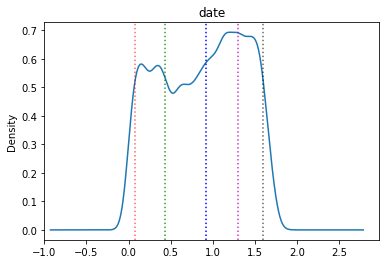

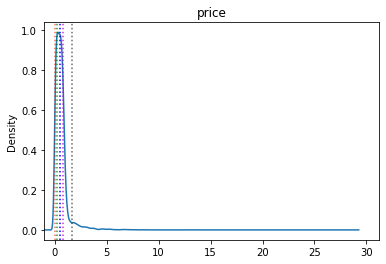

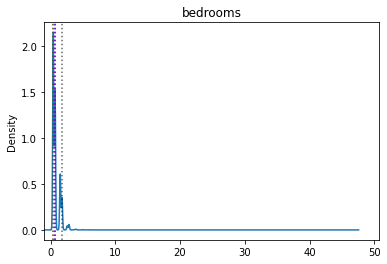

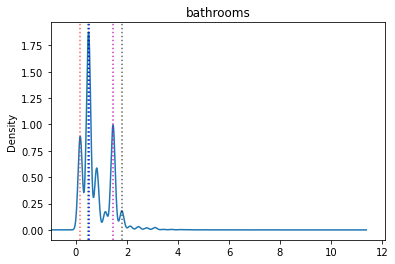

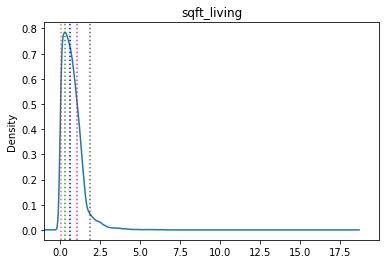

...

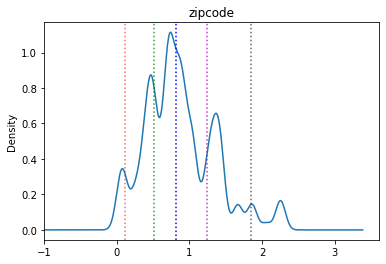

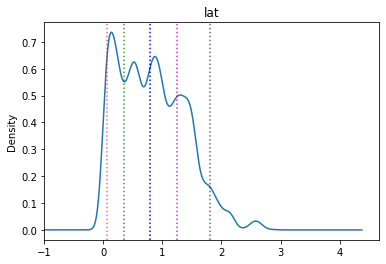

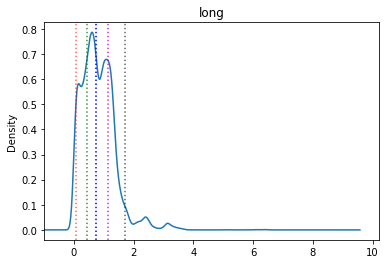

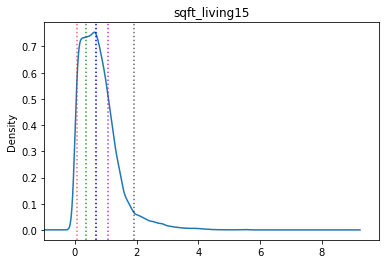

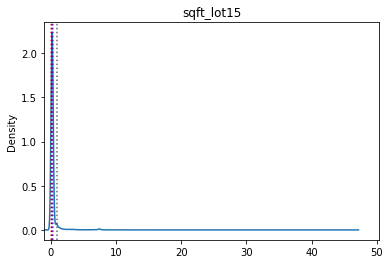

In [8]:
# Droping 'id' column since it is not a feature

data = kc_data.drop(['id',],axis = 1)

columns =[]
for col in data.columns:
    columns.append(col)

# Calculating z-score value
z_score = np.abs(stats.zscore(data))
z_score_df = pd.DataFrame(z_score, columns = columns)
outlier = data[(z_score_df > 5).all(axis=1)]

# Plotting KDE plot for each feature, with five different quantile valuse to give a better understnding of data distribution

for feature in z_score.columns:
    fig, ax = plt.subplots()
    z_score[feature].plot(kind = 'kde')
    ax.set_title(feature)
    
    quant_5, quant_25, quant_50, quant_75, quant_95 = z_score[feature].quantile(0.05), z_score[feature].quantile(0.25), z_score[feature].quantile(0.5), z_score[feature].quantile(0.75), z_score[feature].quantile(0.95)
    quants = [[quant_5, 0.6, 'r'], [quant_25, 0.8, 'g'], [quant_50, 1, 'b'],  [quant_75, 0.8, 'm'], [quant_95, 0.6,'k']]
    for i in quants:
        ax.axvline(i[0],alpha = i[1], linestyle = ":",color = i[2])
    ax.set_xlim(xmin = -1)


<html>
    
<p>As it can be seen from the visualization, there are outliers in some columns:</p>
<ls>
    <li>price</li>
    <li>bedrooms</li>
    <li>bathrooms</li>
    <li>sqft_living</li>
    <li>sqft_lot</li>
    <li>sqft_above</li>
    <li>sqft_basement</li>
</ls>

<p>One way to remove outliers from the data is to set a treshold for all feature's z-score.</p> 

    
<p> Examine outliers by each feature in the below:</p>

    

</html>

In [9]:
data[z_score_df.price>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
246,150,2400000.0,4,2.50,3650,8354,1.0,1,4,3,9,1830,1820,2000,2000,98074,47.6338,-122.072,3120,18841
269,367,2900000.0,4,3.25,5050,20100,1.5,0,2,3,11,4750,300,1982,2008,98004,47.6312,-122.223,3890,20060
300,53,3075000.0,4,5.00,4550,18641,1.0,1,4,3,10,2600,1950,2002,2002,98074,47.6053,-122.077,4550,19508
312,0,2384000.0,5,2.50,3650,9050,2.0,0,4,5,10,3370,280,1921,1921,98119,47.6345,-122.367,2880,5400
656,202,3070000.0,3,2.50,3930,55867,1.0,1,4,4,8,2330,1600,1957,1957,98034,47.7022,-122.224,2730,26324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20460,335,3345000.0,5,3.75,5350,15360,1.0,0,1,3,11,3040,2310,2008,2008,98004,47.6480,-122.218,3740,15940
20535,181,2950000.0,4,4.25,4470,5884,2.0,0,1,3,11,3230,1240,2010,2010,98199,47.6387,-122.405,2570,6000
21040,195,2900000.0,5,4.00,5190,14600,2.0,0,1,3,11,5190,0,2013,2013,98039,47.6102,-122.225,3840,19250
21530,340,3000000.0,4,3.75,5090,14823,1.0,0,0,3,11,4180,910,2013,2013,98004,47.6200,-122.207,3030,12752


In [10]:
data[z_score_df.price>10]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1164,171,5110800.0,5,5.25,8010,45517,2.0,1,4,3,12,5990,2020,1999,1999,98033,47.6767,-122.211,3430,26788
1315,346,5300000.0,6,6.00,7390,24829,2.0,1,4,4,12,5000,2390,1991,1991,98040,47.5631,-122.210,4320,24619
1448,346,5350000.0,5,5.00,8000,23985,2.0,0,4,3,12,6720,1280,2009,2009,98004,47.6232,-122.220,4600,21750
2626,105,4500000.0,5,5.50,6640,40014,2.0,1,4,3,12,6350,290,2004,2004,98155,47.7493,-122.280,3030,23408
3914,40,7062500.0,5,4.50,10040,37325,2.0,1,2,3,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
4411,94,5570000.0,5,5.75,9200,35069,2.0,0,0,3,13,6200,3000,2001,2001,98039,47.6289,-122.233,3560,24345
7252,164,7700000.0,6,8.00,12050,27600,2.5,0,3,4,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
8092,46,4668000.0,5,6.75,9640,13068,1.0,1,4,3,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454
8638,47,4489000.0,4,3.00,6430,27517,2.0,0,0,3,12,6430,0,2001,2001,98004,47.6208,-122.219,3720,14592
9254,140,6885000.0,6,7.75,9890,31374,2.0,0,4,3,13,8860,1030,2001,2001,98039,47.6305,-122.240,4540,42730


In [11]:
data[z_score_df.bedrooms>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
4096,5,599999.0,9,4.50,3830,6988,2.5,0,0,3,7,2450,1380,1938,1938,98103,47.6927,-122.338,1460,6291
4235,249,700000.0,9,3.00,3680,4400,2.0,0,0,3,7,2830,850,1908,1908,98102,47.6374,-122.324,1960,2450
6079,98,1280000.0,9,4.50,3650,5000,2.0,0,0,3,8,2530,1120,1915,2010,98105,47.6604,-122.289,2510,5000
8546,101,450000.0,9,7.50,4050,6504,2.0,0,0,3,7,4050,0,1996,1996,98144,47.5923,-122.301,1448,3866
8757,111,520000.0,11,3.00,3000,4960,2.0,0,0,3,7,2400,600,1918,1999,98106,47.5560,-122.363,1420,4960
13314,104,1148000.0,10,5.25,4590,10920,1.0,0,2,3,9,2500,2090,2008,2008,98004,47.5861,-122.113,2730,10400
15161,180,650000.0,10,2.00,3610,11914,2.0,0,0,4,7,3010,600,1958,1958,98006,47.5705,-122.175,2040,11914
15870,54,640000.0,33,1.75,1620,6000,1.0,0,0,5,7,1040,580,1947,1947,98103,47.6878,-122.331,1330,4700
16844,319,1400000.0,9,4.00,4620,5508,2.5,0,0,3,11,3870,750,1915,1915,98105,47.6684,-122.309,2710,4320
18443,315,934000.0,9,3.00,2820,4480,2.0,0,0,3,7,1880,940,1918,1918,98105,47.6654,-122.307,2460,4400


In [12]:
data[z_score_df.bathrooms>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1315,346,5300000.0,6,6.00,7390,24829,2.0,1,4,4,12,5000,2390,1991,1991,98040,47.5631,-122.210,4320,24619
4024,158,800000.0,7,6.75,7480,41664,2.0,0,2,3,11,5080,2400,1953,1953,98166,47.4643,-122.368,2810,33190
4035,158,2150000.0,8,6.00,4340,9415,2.0,0,0,3,8,4340,0,1967,1967,98004,47.6316,-122.202,2050,9100
7252,164,7700000.0,6,8.00,12050,27600,2.5,0,3,4,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
8092,46,4668000.0,5,6.75,9640,13068,1.0,1,4,3,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454
8546,101,450000.0,9,7.50,4050,6504,2.0,0,0,3,7,4050,0,1996,1996,98144,47.5923,-122.301,1448,3866
9254,140,6885000.0,6,7.75,9890,31374,2.0,0,4,3,13,8860,1030,2001,2001,98039,47.6305,-122.240,4540,42730
12370,369,4208000.0,5,6.00,7440,21540,2.0,0,0,3,12,5550,1890,2003,2003,98006,47.5692,-122.189,4740,19329
12777,3,2280000.0,7,8.00,13540,307752,3.0,0,4,3,12,9410,4130,1999,1999,98053,47.6675,-121.986,4850,217800
14556,40,2888000.0,5,6.25,8670,64033,2.0,0,4,3,13,6120,2550,1965,2003,98177,47.7295,-122.372,4140,81021


In [13]:
data[z_score_df.sqft_living>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1164,171,5110800.0,5,5.25,8010,45517,2.0,1,4,3,12,5990,2020,1999,1999,98033,47.6767,-122.211,3430,26788
1315,346,5300000.0,6,6.00,7390,24829,2.0,1,4,4,12,5000,2390,1991,1991,98040,47.5631,-122.210,4320,24619
1448,346,5350000.0,5,5.00,8000,23985,2.0,0,4,3,12,6720,1280,2009,2009,98004,47.6232,-122.220,4600,21750
2444,222,3278000.0,2,1.75,6840,10000,2.5,1,4,3,11,4350,2490,2001,2001,98008,47.6042,-122.112,3120,12300
2713,89,1110000.0,5,3.50,7350,12231,2.0,0,4,3,11,4750,2600,2001,2001,98065,47.5373,-121.865,5380,12587
3020,150,2525000.0,4,5.50,6930,45100,1.0,0,0,4,11,4310,2620,1950,1991,98006,47.5547,-122.144,2560,37766
3914,40,7062500.0,5,4.50,10040,37325,2.0,1,2,3,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
4024,158,800000.0,7,6.75,7480,41664,2.0,0,2,3,11,5080,2400,1953,1953,98166,47.4643,-122.368,2810,33190
4149,165,4000000.0,4,5.50,7080,16573,2.0,0,0,3,12,5760,1320,2008,2008,98039,47.6151,-122.224,3140,15996
4411,94,5570000.0,5,5.75,9200,35069,2.0,0,0,3,13,6200,3000,2001,2001,98039,47.6289,-122.233,3560,24345


In [14]:
data[z_score_df.sqft_lot>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
145,215,921500.0,4,2.50,3670,315374,2.0,0,0,4,9,3670,0,1994,1994,98077,47.7421,-122.026,2840,87991
527,47,1600000.0,6,5.00,6050,230652,2.0,0,3,3,11,6050,0,2001,2001,98024,47.6033,-121.943,4210,233971
929,98,390000.0,4,3.00,2570,262018,1.0,0,0,3,7,1420,1150,1988,1988,98058,47.4417,-122.090,2260,19811
1045,315,590000.0,3,1.75,1560,242629,1.0,0,0,3,7,1560,0,1981,1981,98053,47.6493,-121.956,2320,220654
1703,220,617000.0,3,1.75,3020,360241,2.0,0,0,3,8,3020,0,1992,1992,98092,47.2662,-122.088,1890,209959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20811,230,580000.0,3,2.50,1820,374616,2.0,0,0,3,7,1820,0,1999,1999,98014,47.6539,-121.959,1870,220654
20974,367,950000.0,3,2.50,2780,275033,1.0,0,0,3,10,2780,0,2006,2006,98045,47.4496,-121.766,1680,16340
21325,194,659000.0,3,2.50,3090,384634,2.0,0,0,3,8,3090,0,2007,2007,98019,47.7072,-121.927,2200,292645
21344,112,1488000.0,5,6.00,6880,279968,2.0,0,3,3,12,4070,2810,2007,2007,98045,47.4624,-121.779,4690,256803


In [15]:
data[z_score_df.sqft_lot>10]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1719,329,700000.0,4,1.00,1300,1651359,1.0,0,3,4,6,1300,0,1920,1920,98022,47.2313,-122.023,2560,425581
2964,201,999000.0,3,2.75,2830,505166,1.0,1,3,4,8,1830,1000,1962,1962,98070,47.3782,-122.514,2120,21988
3949,126,998000.0,4,3.25,3770,982998,2.0,0,0,3,10,3770,0,1992,1992,98058,47.4140,-122.087,2290,37141
4387,17,480000.0,4,3.50,3370,435600,2.0,0,3,3,9,3370,0,2005,2005,98045,47.4398,-121.738,2790,114868
4441,89,790000.0,2,3.00,2560,982278,1.0,0,0,3,8,2560,0,2004,2004,98014,47.6955,-121.861,1620,40946
4540,150,550000.0,3,2.00,3650,843309,2.0,0,0,4,7,3650,0,1991,1991,98070,47.3627,-122.496,1870,273992
5073,311,859000.0,3,2.50,2920,434728,2.0,0,3,4,8,2920,0,1999,1999,98042,47.3809,-122.130,3150,55216
6691,322,1998000.0,2,2.50,3900,920423,2.0,0,0,3,12,3900,0,2009,2009,98065,47.5371,-121.756,2720,411962
7077,248,1650000.0,4,3.25,3920,881654,3.0,0,3,3,11,3920,0,2002,2002,98024,47.5385,-121.896,2970,112384
7250,160,950000.0,4,3.00,3230,438213,2.0,0,0,3,9,3230,0,1999,1999,98070,47.4141,-122.470,1600,144619


In [16]:
data[z_score_df.floors>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [17]:
data[z_score_df.waterfront>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
49,313,1350000.0,3,2.50,2753,65005,1.0,1,2,5,9,2165,588,1953,1953,98070,47.4041,-122.451,2680,72513
230,346,655000.0,2,1.75,1450,15798,2.0,1,4,3,7,1230,220,1915,1978,98166,47.4497,-122.375,2030,13193
246,150,2400000.0,4,2.50,3650,8354,1.0,1,4,3,9,1830,1820,2000,2000,98074,47.6338,-122.072,3120,18841
264,178,369900.0,1,0.75,760,10079,1.0,1,4,5,5,760,0,1936,1936,98070,47.4683,-122.438,1230,14267
300,53,3075000.0,4,5.00,4550,18641,1.0,1,4,3,10,2600,1950,2002,2002,98074,47.6053,-122.077,4550,19508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19984,319,1898000.0,3,2.50,2830,4334,3.0,1,4,3,10,2830,0,2006,2006,98074,47.6318,-122.071,2830,38211
20325,101,3000000.0,3,3.50,4410,10756,2.0,1,4,3,11,3430,980,2014,2014,98056,47.5283,-122.205,3550,5634
20767,350,2300000.0,4,4.00,4360,8175,2.5,1,4,3,10,3940,420,2007,2007,98008,47.5724,-122.104,2670,8525
21201,159,2230000.0,3,3.50,3760,5634,2.0,1,4,3,11,2830,930,2014,2014,98056,47.5285,-122.205,3560,5762


In [18]:
data[z_score_df.view>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [19]:
data[z_score_df.condition>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [20]:
data[z_score_df.grade>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
19452,147,142000.0,0,0.0,290,20875,1.0,0,0,1,1,290,0,1963,1963,98024,47.5308,-121.888,1620,22850


In [21]:
data[z_score_df.sqft_above>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
419,69,1550000.0,5,4.25,6070,171626,2.0,0,0,3,12,6070,0,1999,1999,98024,47.5954,-121.950,4680,211267
527,47,1600000.0,6,5.00,6050,230652,2.0,0,3,3,11,6050,0,2001,2001,98024,47.6033,-121.943,4210,233971
1100,192,1570000.0,5,4.50,6070,14731,2.0,0,0,3,11,6070,0,2004,2004,98059,47.5306,-122.134,4750,13404
1164,171,5110800.0,5,5.25,8010,45517,2.0,1,4,3,12,5990,2020,1999,1999,98033,47.6767,-122.211,3430,26788
1448,346,5350000.0,5,5.00,8000,23985,2.0,0,4,3,12,6720,1280,2009,2009,98004,47.6232,-122.220,4600,21750
2626,105,4500000.0,5,5.50,6640,40014,2.0,1,4,3,12,6350,290,2004,2004,98155,47.7493,-122.280,3030,23408
3121,199,1320000.0,4,5.25,6110,10369,2.0,0,0,3,11,6110,0,2005,2005,98059,47.5285,-122.135,4190,10762
3914,40,7062500.0,5,4.50,10040,37325,2.0,1,2,3,11,7680,2360,1940,2001,98004,47.6500,-122.214,3930,25449
4411,94,5570000.0,5,5.75,9200,35069,2.0,0,0,3,13,6200,3000,2001,2001,98039,47.6289,-122.233,3560,24345
4811,306,2479000.0,5,3.75,6810,7500,2.5,0,0,3,13,6110,700,1922,1922,98102,47.6285,-122.322,2660,7500


In [22]:
data[z_score_df.sqft_basement>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2088,131,1195000.0,5,3.25,5180,19606,1.0,0,0,3,11,2610,2570,1993,1993,98006,47.5550,-122.114,4050,15296
2125,88,1325000.0,3,3.75,6400,76665,1.0,0,2,4,10,3810,2590,1966,1966,98177,47.7313,-122.370,3430,60548
2713,89,1110000.0,5,3.50,7350,12231,2.0,0,4,3,11,4750,2600,2001,2001,98065,47.5373,-121.865,5380,12587
3020,150,2525000.0,4,5.50,6930,45100,1.0,0,0,4,11,4310,2620,1950,1991,98006,47.5547,-122.144,2560,37766
4411,94,5570000.0,5,5.75,9200,35069,2.0,0,0,3,13,6200,3000,2001,2001,98039,47.6289,-122.233,3560,24345
5049,28,1385000.0,6,2.75,5700,20000,1.0,0,4,4,10,2850,2850,1977,1977,98006,47.5601,-122.160,3690,15700
6628,151,850000.0,4,2.75,5440,239580,1.0,0,0,2,9,2720,2720,1969,1969,98001,47.3540,-122.293,1970,40392
7035,60,3800000.0,5,5.50,7050,42840,1.0,0,2,4,13,4320,2730,1978,1978,98004,47.6229,-122.220,5070,20570
7252,164,7700000.0,6,8.00,12050,27600,2.5,0,3,4,13,8570,3480,1910,1987,98102,47.6298,-122.323,3940,8800
8092,46,4668000.0,5,6.75,9640,13068,1.0,1,4,3,12,4820,4820,1983,2009,98040,47.5570,-122.210,3270,10454


In [23]:
data[z_score_df.yr_built>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [24]:
data[z_score_df.yr_renovated>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [25]:
data[z_score_df.zipcode>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [26]:
data[z_score_df.lat>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


In [27]:
data[z_score_df.long>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2589,6,134000.0,2,1.50,980,5000,2.0,0,0,3,7,980,0,1922,2003,98014,47.7076,-121.359,1040,5000
2927,363,167000.0,1,1.00,780,10235,1.5,0,0,3,6,780,0,1989,1989,98014,47.7130,-121.315,930,10165
4203,68,150000.0,3,0.75,490,38500,1.5,0,0,4,5,490,0,1959,1959,98014,47.7112,-121.315,800,18297
4848,19,525000.0,3,2.75,2100,10362,2.0,0,0,3,9,1510,590,1998,1998,98045,47.4347,-121.417,2240,11842
5867,95,175000.0,2,1.75,1050,9800,1.5,0,0,4,6,1050,0,1975,1975,98019,47.7595,-121.473,1230,12726
6089,349,150000.0,3,1.00,890,6488,1.5,0,0,3,5,890,0,1928,1928,98014,47.7087,-121.352,1330,16250
10095,193,200000.0,2,1.75,1320,13052,1.5,0,0,3,7,1320,0,1980,1980,98014,47.7120,-121.352,1320,13052
10898,173,241000.0,2,1.75,1070,9750,1.5,0,0,3,7,1070,0,1995,1995,98014,47.7131,-121.319,970,9750
13072,161,155000.0,2,1.00,1010,43056,1.5,0,0,3,5,1010,0,1990,1990,98014,47.7105,-121.316,830,18297
13249,350,375000.0,3,1.75,2140,13598,1.5,0,0,4,7,1620,520,1970,1970,98014,47.7139,-121.321,930,10150


In [28]:
data[z_score_df.sqft_living15>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1123,54,1200000.0,4,1.75,3990,13470,2.0,0,0,3,11,3990,0,2006,2006,98059,47.5305,-122.131,5790,13709
1530,117,1250000.0,4,3.75,3830,41263,2.0,0,0,4,11,3830,0,1990,1990,98077,47.7237,-122.042,5600,56568
5451,161,1780000.0,4,3.25,4890,13402,2.0,0,0,3,13,4890,0,2004,2004,98059,47.5303,-122.131,5790,13539
10373,224,2983000.0,5,5.50,7400,18898,2.0,0,3,3,13,6290,1110,2001,2001,98006,47.5431,-122.112,6110,26442
11871,255,1950000.0,4,3.25,7420,167869,2.0,0,3,3,12,7420,0,2002,2002,98045,47.4548,-121.764,5610,169549
12713,361,2408000.0,5,2.50,4600,23250,1.5,0,2,3,9,3600,1000,1918,2003,98004,47.6230,-122.218,5500,20066
16430,276,1750000.0,6,4.25,5860,13928,2.0,0,3,3,10,4150,1710,2013,2013,98006,47.5382,-122.114,5790,13928
19858,265,2700000.0,4,4.00,7850,89651,2.0,0,0,3,12,7850,0,2006,2006,98027,47.5406,-121.982,6210,95832
20563,94,1240420.0,5,3.25,5790,13726,2.0,0,3,3,10,4430,1360,2014,2014,98006,47.5388,-122.114,5790,13726
20830,153,1750000.0,5,3.25,5790,12739,2.0,0,3,3,10,4430,1360,2014,2014,98006,47.5380,-122.114,5790,13928


In [29]:
data[z_score_df.sqft_lot15>5]

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
147,96,430000.0,2,2.50,2420,60984,2.0,0,0,3,7,2420,0,2007,2007,98027,47.5262,-121.943,1940,193842
416,55,563500.0,4,1.75,2085,174240,1.0,0,0,3,7,1610,475,1964,1964,98024,47.5753,-121.950,2690,174240
419,69,1550000.0,5,4.25,6070,171626,2.0,0,0,3,12,6070,0,1999,1999,98024,47.5954,-121.950,4680,211267
443,355,350000.0,3,1.50,1250,219978,1.0,0,0,4,6,1250,0,1980,1980,98038,47.4056,-121.955,1930,210394
484,343,1385000.0,4,3.25,4860,181319,2.5,0,0,3,9,4860,0,1993,1993,98074,47.6179,-122.005,3850,181319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21325,194,659000.0,3,2.50,3090,384634,2.0,0,0,3,8,3090,0,2007,2007,98019,47.7072,-121.927,2200,292645
21344,112,1488000.0,5,6.00,6880,279968,2.0,0,3,3,12,4070,2810,2007,2007,98045,47.4624,-121.779,4690,256803
21351,172,565000.0,2,1.75,1130,276170,1.0,0,0,3,8,1130,0,2006,2006,98022,47.2673,-122.027,2092,217800
21431,7,800000.0,4,3.25,3540,159430,2.0,0,0,3,9,3540,0,2007,2007,98014,47.6285,-121.899,1940,392040


# Summary and Decision on removal or modification

1) Feature with obvious wrong or self-contradictory data
bedrooms: one outlier has 33 bedrooms but with only 1620 sqft_living, which is impossible. This record (#15870) should be removed. Other outliers are 9-11, reasonable when compared with the size, possibly multi-family homes.

2) Features with no outliers detected by threshold in the above: floors, view, condition, grade, yr_built, yr_renovated, zipcode, lat

Among these above features, further checking:

floors: whole range within 1-3.5, looks sensible.

view, condition and grade: all fall within defined range

yr_built: oldest is 1900, not usual but possible

yr_renovated: 
oldest is 1934 - looks odd, but more important issue is its overall data quality alerted by sparse data - only 5% is non-zero, so on average a house is renovated only every 20 years, perhaps still reasonable overall, but with some very old years of renovation, and subjective definition of major renovation, instead of taking out a few records, we may need to consider whether to use this feature (to be examined during further checking or training). One alternative is to consider modification by replacing zero with the value of yr_built, as this year should reflect the condition of those properties truly without renovation. Also, another problem is whether this feature (if of good data quality) would be redundant given that there is already a feature "condition".

zipcode: confirmed with list of zipcodes of King County

lat: using Google Map, the range of King County should be 47.08 to 47.78, the data is consistent with this range

3) Features with outliers but can be explained trivially

long: using Google Map, the range of King County shoud be -122.53 to -121.06, the data is consistent with this range

waterfront: 
all outliers are labelled 1, and actually it is defined as either 0 or 1 with only 0.8% labelled as 1, so this is data sparsity or potentially data quality issue instead. Depending on the landscape the data may be genuinely sparse. Instead of removing all these outliers, we should consider whether this feature should be used (to be examined during further checking or training), as there is also another issue - whether it is redundant given that there is already a feature "view".

bathrooms: outliers are at 6-8, reasonable when compared with size (at least 4050 sqft_living)

4) Features about size and price

Sqft_living: note that it is simply the sum of sqft_above and sqft_basement - so one of these feature columns should be removed for data training. Among these 3 features we focus on sqft_living, which can be up to 13540 - this is rare but possible as the largest house for sale in Seattle is around this size.

Sqft_living15: similar to sqft_living but it refers to nearest 15 neighbours'average sqft_living. Outliers up to 6210. By similar argument as sqft_living, it is rare but possible. 

Sqft_lot: outliers up to 1651359 , a very large number but it can be the case for farmhouse with large land lot. We give the benefit of doubt to data as this feature is hard to judge correctness by itself. 

Sqft_lot15: similar to sqft_lot, we give benefit of doubt to data.

Price: with second screening using threshold at z score of 10, outliers are at 4.5m - 7.7m, all with sizeable sqft_living, and these amounts are in par with the most luxuary homes in Seattle. 



In [30]:
cleaned = data.drop(labels=15870 , axis = 0)
cleaned

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,164,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,1955,98178,47.5112,-122.257,1340,5650
1,221,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,299,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,1933,98028,47.7379,-122.233,2720,8062
3,221,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,1965,98136,47.5208,-122.393,1360,5000
4,292,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,2009,98103,47.6993,-122.346,1530,1509
21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,2014,98146,47.5107,-122.362,1830,7200
21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,2009,98144,47.5944,-122.299,1020,2007
21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,2004,98027,47.5345,-122.069,1410,1287


# Finding Co-related columns

<html>
    
<p>In this step we will remove features that are highly co-related to each other, since keeping both of them in the dataset would affect the accuracy of our models to predict price of a house based on its features. First, we would visualize pair graphs among data features, and after that using a correlation matrix, we would correct data features.</p>
    

</html>

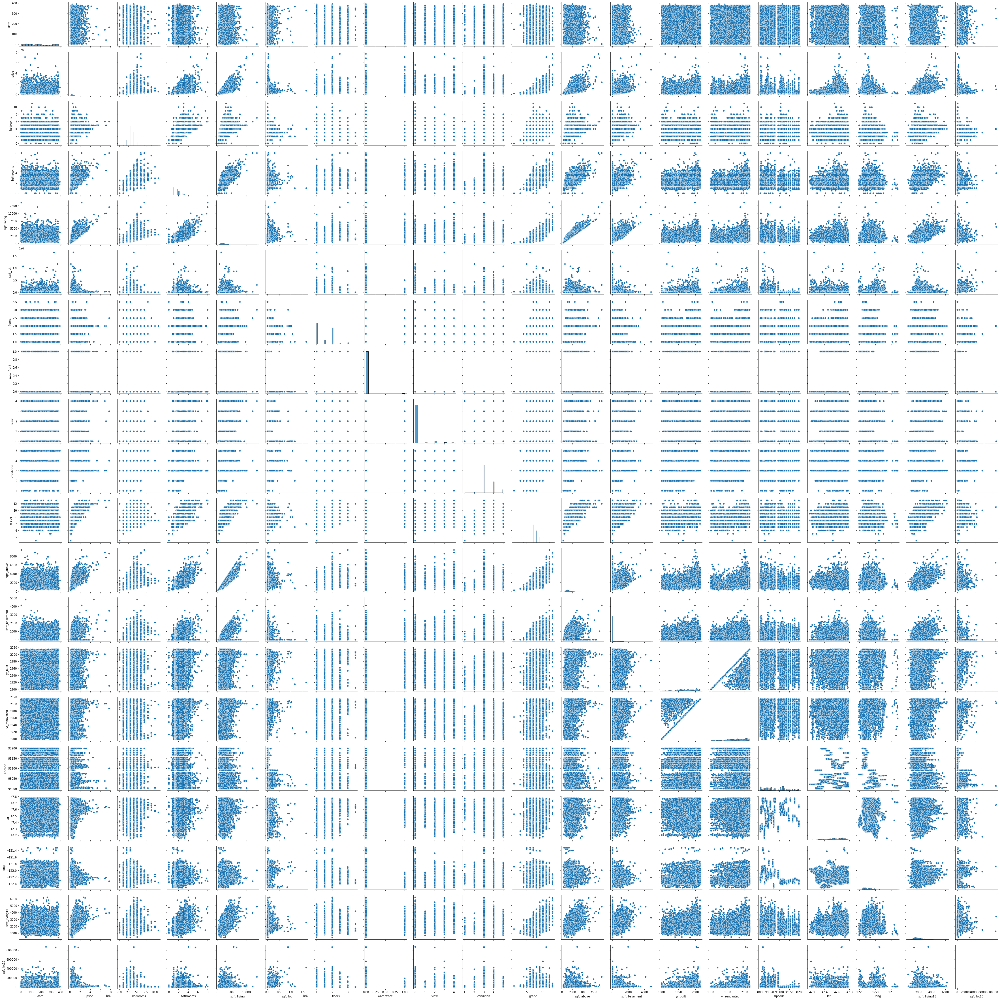

In [31]:
sns.pairplot(cleaned)

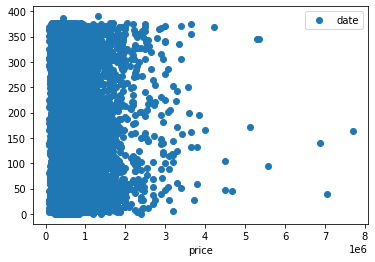

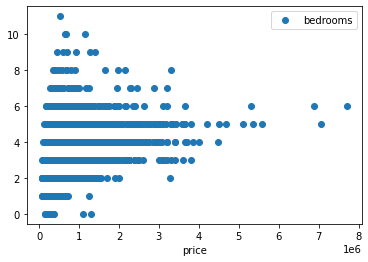

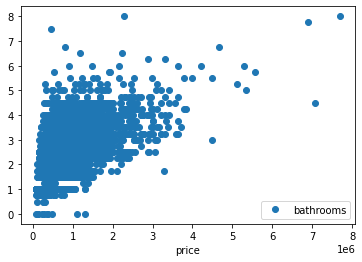

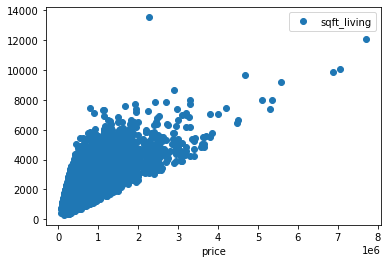

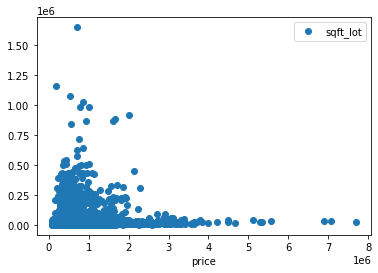

...

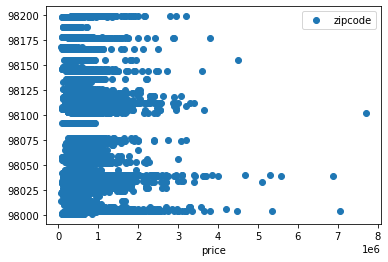

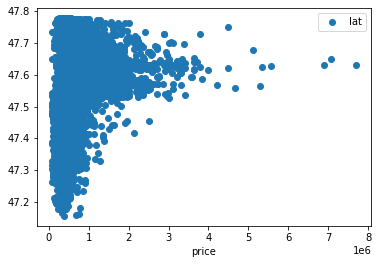

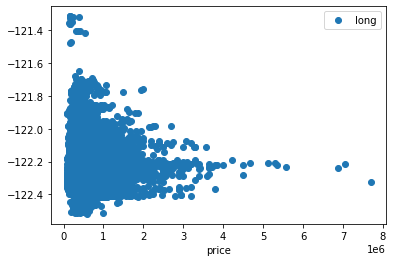

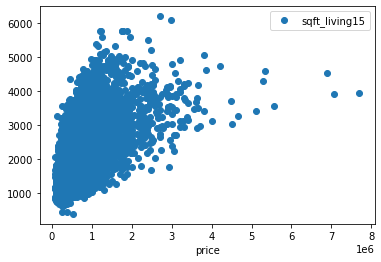

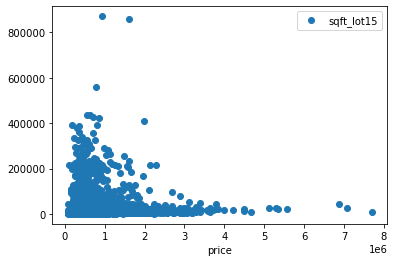

In [32]:
columns = list(cleaned.columns)
columns.remove('price')


for feature in columns:
    cleaned.plot(x='price', y=feature , style='o')
    

<AxesSubplot:>

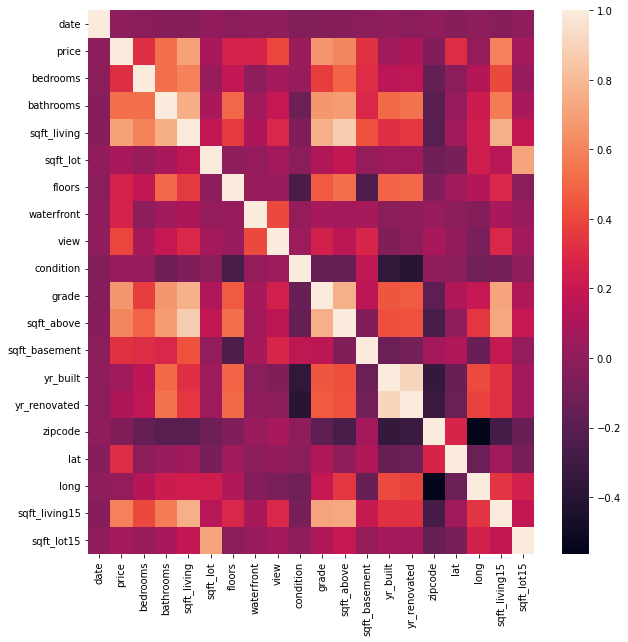

In [33]:
# Creating pearson correlation matrix and ploting it
cor_mat = cleaned.corr(method= 'pearson')
fig = plt.figure(figsize=(10,10))
sns.heatmap(cor_mat)

<html>
    
<p>Since sqft_basement is linear combination of other layers, it can be removed from the datafram. </p>
    

</html>

In [34]:
final_v_dataset = cleaned.drop(['sqft_basement',], axis = 1)



In [35]:
# Install a pip package in the current Jupyter kernel to install folium for next cells
import sys
!{sys.executable} -m pip install folium

<html>
    
<p>In this final section we would examine latitude and lonitude numbers for our data. For this examination we use folium library, which can be installed easily.</p>
   

</html>

In [36]:
# note that for running this block folium should be installed

import folium


#selecting appropriate zoom level for visualization

king_county_map = folium.Map(location = [47.49, -121.99], zoom_start= 9) #selecting a location arround king county
king_county_features = folium.map.FeatureGroup()

#plot every node in the data
for lat, long in zip(cleaned['lat'],cleaned['long']):
    king_county_features.add_child(folium.features.CircleMarker([lat,long], radius=1, color = 'red',)) 

    king_county_map.add_child(king_county_features)

king_county_map

<html>
    
<p>As it can been seen, all locations are within a reasonable region of Washington states. </p>
   

</html>

<html>
    
<p>Finally we can save our result, which is ready to be used by our models.</p>
   

</html>

In [37]:
final_v_dataset.to_csv(path + 'kc_preprocessed.csv')

final_v_dataset

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,164,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,1955,1955,98178,47.5112,-122.257,1340,5650
1,221,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,1951,1991,98125,47.7210,-122.319,1690,7639
2,299,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,1933,1933,98028,47.7379,-122.233,2720,8062
3,221,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,1965,1965,98136,47.5208,-122.393,1360,5000
4,292,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,2009,2009,98103,47.6993,-122.346,1530,1509
21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,2014,2014,98146,47.5107,-122.362,1830,7200
21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,2009,2009,98144,47.5944,-122.299,1020,2007
21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,2004,2004,98027,47.5345,-122.069,1410,1287


# Linear Regression

The purpose of this sectionn is to use linear regression to provide baseline performance metrics. First, import and load source data and split data into train, test, final test data by 60/20/20 ratio.

In [38]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import datetime
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [39]:
kc_data = final_v_dataset

Clean data. Remove obviously wrong record with 33 bedrooms, detected in "Outlier checking.ipynb". Then split data into train, test, final test data by 60/20/20 ratio.

In [40]:
y = kc_data['price']
X = kc_data.drop('price', axis=1)

# split the train, test and final test data

X_train, X_final_test, y_train, y_final_test = train_test_split(X, y, test_size=0.2, random_state=42) 
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.25, random_state=42) 

#-------------above: data clean and split--------------------------------------------

Then fit the data into linear regression model.

In [41]:


#get (and print) coefficients and estimates of linear regression model, given data X, y
def print_coef(X, y, X_test=X, y_test=y, to_print=True):
    reg = LinearRegression().fit(X, y)
    score=reg.score(X, y)
    coef=reg.coef_
    intercept=reg.intercept_
    ss_residual = np.linalg.norm(y - reg.predict(X)) ** 2
    RMSE = (ss_residual/len(y))**0.5
    ss_residual_test = np.linalg.norm(y_test - reg.predict(X_test)) ** 2
    RMSE_test = (ss_residual_test/len(y_test))**0.5
    score_test = 1-ss_residual_test/(np.var(y_test)*len(y_test))
    if to_print:
        print("intercept: "+str(intercept)+"; coef: "+str(coef))
        print("----Training result----")
        print("R2: "+str(score))
        print("RMSE: "+str(RMSE))
        print("y_mean: "+str(np.average(y)))
        print("RMSE/y_mean: "+str(RMSE/np.average(y)))
        print("----Testing result----")
        print("R2: "+str(score_test))
        print("RMSE: "+str(RMSE_test))
        print("y_mean: "+str(np.average(y_test)))
        print("RMSE/y_mean: "+str(RMSE/np.average(y_test)))
    return     intercept, coef, score, ss_residual, RMSE, reg


intercept, coef, score, ss_residual, RMSE, reg =print_coef(X_train, y_train, X_test, y_test)
print

intercept: 9657523.95804404; coef: [ 1.20258257e+02 -4.04473513e+04  4.93830862e+04  1.62007974e+02
  4.27530290e-02  1.09845693e+04  6.10578292e+05  5.07837919e+04
  2.44355533e+04  9.16166056e+04  2.32774681e+01 -3.48296987e+03
  7.00015336e+02 -5.54338171e+02  5.94154326e+05 -1.73956334e+05
  1.63599511e+01 -2.65210272e-01]
----Training result----
R2: 0.7062429048241645
RMSE: 197582.2632828728
y_mean: 539542.543267006
RMSE/y_mean: 0.36620330639078874
----Testing result----
R2: 0.6829026276334511
RMSE: 199143.6287915729
y_mean: 535019.4573213046
RMSE/y_mean: 0.36929921067191257


<function print>

In [42]:
print("For comparison, y_sigma/y_mean =")
print(np.var(y_test)**0.5/np.average(y_test))

For comparison, y_sigma/y_mean =
0.6609985677070676


# Nearest Neighbour

The purpose of this sectionn is to use nearest neighbour algorithm to predict house price. First, import and load source data.

In [43]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import datetime
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.neighbors import NearestNeighbors, KNeighborsRegressor, RadiusNeighborsRegressor
from sklearn.decomposition import PCA


In [44]:
kc_data = final_v_dataset

In [45]:
y = kc_data['price']
X = kc_data.drop(['price'], axis = 1)

Split data into train, test, final test data by 60/20/20 ratio.

In [46]:
# split the train, test and final test data
X_train, X_final_test, y_train, y_final_test = train_test_split(X, y, test_size=0.2, random_state=42) 
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.25, random_state=42) 


#-------------above: data clean and split--------------------------------------------

Then transform input data by standard normal distribution.

In [47]:
#standard normalization, using training data mean and sigma for test data as well for consistency with model
def X_norm(X):   
        mean = np.average(X_train, axis=0)
        sigma = np.var(X_train, axis=0)**0.5
        X_new = (X - mean )/sigma
        return X_new
    
def y_norm(y):
        mean = np.average(y_train, axis=0)
        sigma = np.var(y_train, axis=0)**0.5
        y_new = (y - mean )/sigma
        return y_new

In [48]:
X_train_norm = X_norm(X_train)
X_test_norm = X_norm(X_test)
y_train_norm = y_norm(y_train)
y_test_norm = y_norm(y_test)
print(X_train_norm)
print(X_train_norm.iloc[0])
print(X_train_norm.loc[3086])

           date  bedrooms  bathrooms  sqft_living  sqft_lot    floors  \
295   -0.988310  0.700497   0.498111     1.400390  0.167790  0.918016   
3086   1.603723 -1.527280  -1.454672    -1.050993 -0.238216 -0.923555   
6962  -1.430636 -0.413391   1.474502     1.761531 -0.191261  0.918016   
4249  -0.298281  0.700497   0.823574     1.214347 -0.234412  0.918016   
8903  -0.802533  0.700497   0.498111     0.853206 -0.230366  0.918016   
...         ...       ...        ...          ...       ...       ...   
15611  1.462178  0.700497  -0.478281    -0.438147  0.102630 -0.923555   
20028  0.621758  1.814386   1.799966     2.013236 -0.240624  0.918016   
6189  -0.448672  1.814386   0.823574     1.400390 -0.143102  0.918016   
5106  -0.059424 -0.413391  -0.478281    -0.569471 -0.190177 -0.002770   
20858 -0.254048 -1.527280  -0.803744    -0.700796 -0.347176  0.918016   

       waterfront      view  condition     grade  sqft_above  yr_built  \
295     -0.086819 -0.307305  -0.621478  1.992210 

Then fit to nearest neighbour model. Select KD tree algorithm for the model as it is good for large number of samples with dimension < 20.

In [49]:
for k in range(1,21):
    neigh = KNeighborsRegressor(n_neighbors=k, weights='distance', algorithm='kd_tree')
    neigh.fit(X_train_norm, y_train)
    print("R2 for k="+str(k)+": "+str(neigh.score(X_test_norm, y_test)))

R2 for k=1: 0.6901725527613745
R2 for k=2: 0.7552395717608497
R2 for k=3: 0.7693189773944258
R2 for k=4: 0.7759246717797783
R2 for k=5: 0.7803945007115813
R2 for k=6: 0.7839421589933107
R2 for k=7: 0.7866082334798119
R2 for k=8: 0.7845751254923023
R2 for k=9: 0.7846116691054191
R2 for k=10: 0.785483464197351
R2 for k=11: 0.7850799431953828
R2 for k=12: 0.7828208559838776
R2 for k=13: 0.782766011738143
R2 for k=14: 0.7819475686496141
R2 for k=15: 0.779168056232252
R2 for k=16: 0.7783465335627124
R2 for k=17: 0.7768733453369341
R2 for k=18: 0.7752940156055214
R2 for k=19: 0.7742979435658555
R2 for k=20: 0.7738430762965934


From above, k = 7 produces the best score when all features are included.

# First Trial Combining with Linear Regression

In [50]:
X_test_neigh = neigh.kneighbors(X_test_norm, return_distance=False)
print(np.max(X_test_neigh)) #double check it is the max index 12966-1

12965


Above line is to get the neighbour points. What if we combine and use linear regression for neighbour points instead of just an average over these points? Let's have first trial using 20 neighbours of the first test point.

In [51]:
X_in = X_train_norm.iloc[X_test_neigh[0]]
y_in = y_train_norm.iloc[X_test_neigh[0]]
reg=LinearRegression().fit(X_in, y_in)
print("intercept: "+str(reg.intercept_)+"; coef: "+str(reg.coef_))

print('y_norm predicted by KNN alone:'+str(y_norm(neigh.predict(X_test_norm.iloc[0].to_numpy().reshape((1,-1))))))
print('y_norm predicted by linear + KNN: '+str(reg.predict(X_test_norm.iloc[0].to_numpy().reshape((1,-1)))))
print('y_norm actual:'+str(y_test_norm.iloc[0]))

intercept: 0.2031328232945711; coef: [ 4.61245431e-02 -1.17885819e-01 -5.04784083e-02  3.41904828e-01
 -7.54991813e-01 -7.09857436e-02  2.22044605e-16  6.10622664e-16
 -9.03429331e-02  3.33069979e-02 -1.49710253e-01  2.30326492e-01
  2.35264825e-01 -1.12263323e-02  3.17616496e-01 -2.81281856e-01
 -1.57877913e-01  8.00451797e-01]
y_norm predicted by KNN alone:[-0.47087935]
y_norm predicted by linear + KNN: [-0.81977132]
y_norm actual:-0.7531056036958295


In [52]:
reg_train=LinearRegression().fit(X_train_norm, stats.zscore(y_train))
print("intercept: "+str(reg_train.intercept_)+"; coef: "+str(reg_train.coef_))

intercept: -1.231135889973933e-14; coef: [ 0.03728965 -0.09960807  0.10405474  0.40608736  0.00487039  0.01636217
  0.14432443  0.10642428  0.04362966  0.29500055  0.05261841 -0.28107073
  0.05530448 -0.08098474  0.22564524 -0.06738594  0.0305894  -0.02123068]


The frist trial (using the first test record) of combining with linear regreesion has better performance than KNN alone!

Let's examine further. Small coefficients may imply insignificance of corresponding variables. As nearest neighbour method does not give different weight to each dimension, including feature that is not important may hurt the influence of other important features and overall performance. Try again by dropping sqft_lot, floors, yr_renovated, sqft_living15, sqft_lot15, or try each one generally

In [53]:
#X_train_drop = X_train.drop(['sqft_lot','floors','yr_renovated','sqft_living15','sqft_lot15'], axis=1)
#X_test_drop = X_test.drop(['sqft_lot','floors','yr_renovated','sqft_living15','sqft_lot15'], axis=1)

max_score={}
max_score_k={}
for feature in X_train.columns:  
    max_score[feature]=0
    max_score_k[feature]=0
    for k in range(1,21):
        X_train_drop = X_train.drop([feature], axis=1)
        X_test_drop = X_test.drop([feature], axis=1)
        neigh = KNeighborsRegressor(n_neighbors=k, weights='distance', algorithm='kd_tree')
        neigh.fit(stats.zscore(X_train_drop), y_train)
        temp = neigh.score(stats.zscore(X_test_drop), y_test)
        if temp > max_score[feature]:
            max_score[feature]=temp
            max_score_k[feature]=k
    print("R2 for k="+str(max_score_k[feature])+", drop "+feature+": "+str(max_score[feature]))

R2 for k=5, drop date: 0.7978550007370097
R2 for k=10, drop bedrooms: 0.796076051095866
R2 for k=9, drop bathrooms: 0.7972616504005778
R2 for k=7, drop sqft_living: 0.7774798069400735
R2 for k=8, drop sqft_lot: 0.7897353815265381
R2 for k=8, drop floors: 0.794808184876425
R2 for k=13, drop waterfront: 0.780622613063982
R2 for k=6, drop view: 0.8018300845945656
R2 for k=9, drop condition: 0.794459191216299
R2 for k=10, drop grade: 0.7664373373593112
R2 for k=6, drop sqft_above: 0.7883099714806779
R2 for k=7, drop yr_built: 0.787043954983182
R2 for k=7, drop yr_renovated: 0.7880850410562545
R2 for k=9, drop zipcode: 0.7838195605558239
R2 for k=9, drop lat: 0.7215526717465148
R2 for k=9, drop long: 0.7676557193865654
R2 for k=9, drop sqft_living15: 0.7828951851314768
R2 for k=8, drop sqft_lot15: 0.7915952573328573


From the above, best performace occurs around k=9, and generally droping one feature may not improve the score much, and it may hurt performance for dropping some important feature, notably such as lat, long, sqft_living, grade. Let's see what if only lat, long, sqft_living, grade are included?

In [54]:
X_train_drop = X_train[['lat','long']]
X_test_drop = X_test[['lat', 'long']]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(neigh.score(stats.zscore(X_test_drop), y_test))

0.5385006155130563


In [55]:
X_train_drop = X_train[['sqft_living','lat','long']]
X_test_drop = X_test[['sqft_living','lat', 'long']]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(neigh.score(stats.zscore(X_test_drop), y_test))

0.7863816045518219


In [56]:
X_train_drop = X_train[['sqft_living','grade','lat','long']]
X_test_drop = X_test[['sqft_living','grade','lat', 'long']]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(neigh.score(stats.zscore(X_test_drop), y_test))

0.8161225057554446


We should note that only lat, long, sqft_living already gives the same performance vs all the features! 

And it may help if only add some more features selectively.

In [60]:
np.random.seed(42)
print("R2 score after adding one feature at a time to sqft_living, lat, long")
print("----------------")
for feature in set(X_train.columns) - {'sqft_living','lat','long'}:
    X_train_drop = X_train[['sqft_living','lat','long',feature]]
    X_test_drop = X_test[['sqft_living','lat', 'long',feature]]
    neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
    neigh.fit(stats.zscore(X_train_drop), y_train)
    print(feature+": "+str(neigh.score(stats.zscore(X_test_drop), y_test)))

R2 score after adding one feature at a time to sqft_living, lat, long
----------------
date: 0.7685053526953152
sqft_above: 0.7843511287039105
zipcode: 0.7849201260325311
view: 0.8047982179218391
condition: 0.7803044553311679
waterfront: 0.821509437622671
yr_renovated: 0.7971769791818187
sqft_lot15: 0.7992146886212602
bedrooms: 0.7790371290613699
grade: 0.8161225057554446
bathrooms: 0.7674873434583119
floors: 0.7855795667937342
yr_built: 0.796920115328263
sqft_lot: 0.8021446280084724
sqft_living15: 0.8010795758186134


Unexpected, sparsely variable waterfront is the best! Let's further add selectively according to the above scores.

In [61]:
try_feature = ['sqft_living','lat','long','waterfront', 'grade']
X_train_drop = X_train[try_feature]
X_test_drop = X_test[try_feature]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(str(try_feature)+" R2 score: "+str(neigh.score(stats.zscore(X_test_drop), y_test)))

['sqft_living', 'lat', 'long', 'waterfront', 'grade'] R2 score: 0.8481984591996712


In [62]:
try_feature = ['sqft_living','lat','long','waterfront', 'grade','view']
X_train_drop = X_train[try_feature]
X_test_drop = X_test[try_feature]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(str(try_feature)+" R2 score: "+str(neigh.score(stats.zscore(X_test_drop), y_test)))

['sqft_living', 'lat', 'long', 'waterfront', 'grade', 'view'] R2 score: 0.846154452635744


In [63]:
try_feature = ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
X_train_drop = X_train[try_feature]
X_test_drop = X_test[try_feature]
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(stats.zscore(X_train_drop), y_train)
print(str(try_feature)+" R2 score: "+str(neigh.score(stats.zscore(X_test_drop), y_test)))

['sqft_living', 'lat', 'long', 'waterfront', 'grade', 'sqft_lot'] R2 score: 0.8550857254181614


In [64]:
def metrics(y_predict, y_true):  #given predicted and true values, return dictionary of R2, RMSE, RMSE/mean, average abs % error
    metrics={}
    residual = y_predict - y_true
    average = np.average(y_true)
    abs_percent_error = np.absolute(np.divide(residual,y_true))*100
    metrics['R2'] = 1 - (np.sum(residual**2)/len(residual))/np.var(y_true)
    metrics['RMSE']= (np.sum(residual**2)/len(residual))**0.5
    metrics['RMSE/mean'] = metrics['RMSE'] / average
    metrics['average absolute % error'] = np.average(abs_percent_error)
    metrics['median absolute % error'] = np.median(abs_percent_error)
    return metrics


## The best features are ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
The median absolute % error is below 10%.

In [ ]:
metrics(neigh.predict(X_test_norm[['sqft_living','lat','long','waterfront', 'grade','sqft_lot']]), y_test)

# Trying combination with Linear Regression again

Now we try to combine KNN with linear regression, by using neighbours as data points to do separate linear regression for every validation data sample. We will try with different sets of most important linear variables: ['sqft_living','grade','sqft_lot'], ['sqft_living','grade'], ['sqft_living']

In [65]:
y_linear_knn =[]
knn_features = ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
linear_features = ['sqft_living','grade','sqft_lot'] #exclude map-related info
X_test_neigh = neigh.kneighbors(X_test_norm[knn_features], return_distance=False)

for i in range(len(X_test)):
    X_in = X_train_norm[linear_features].iloc[X_test_neigh[i]]
    y_in = y_train_norm.iloc[X_test_neigh[i]]
    reg=LinearRegression().fit(X_in, y_in)
    y_linear_knn.append(reg.predict(X_test_norm[linear_features].iloc[i].to_numpy().reshape((1,-1))))



In [66]:
y_linear_knn_unnorm = np.squeeze(y_linear_knn)* (np.var(y_train)**0.5) + np.average(y_train)
metrics(y_linear_knn_unnorm, y_test)

{'R2': 0.7903444127110411,
 'RMSE': 161928.50837267356,
 'RMSE/mean': 0.3026591017519346,
 'average absolute % error': 16.274907435280472,
 'median absolute % error': 10.805301587678878}

In [67]:
y_linear_knn =[]
knn_features = ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
linear_features = ['sqft_living','grade'] #exclude map-related info and further exclude 'sqft_lot' which is less important
X_test_neigh = neigh.kneighbors(X_test_norm[knn_features], return_distance=False)

for i in range(len(X_test)):
    X_in = X_train_norm[linear_features].iloc[X_test_neigh[i]]
    y_in = y_train_norm.iloc[X_test_neigh[i]]
    reg=LinearRegression().fit(X_in, y_in)
    y_linear_knn.append(reg.predict(X_test_norm[linear_features].iloc[i].to_numpy().reshape((1,-1))))

In [68]:
y_linear_knn_unnorm = np.squeeze(y_linear_knn)* (np.var(y_train)**0.5) + np.average(y_train)
metrics(y_linear_knn_unnorm, y_test)

{'R2': 0.8177403350411914,
 'RMSE': 150978.59472544424,
 'RMSE/mean': 0.2821927177776909,
 'average absolute % error': 15.18620321254382,
 'median absolute % error': 10.447530864197528}

In [69]:
y_linear_knn =[]
knn_features = ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
linear_features = ['sqft_living'] #test by only one feature
X_test_neigh = neigh.kneighbors(X_test_norm[knn_features], return_distance=False)

for i in range(len(X_test)):
    X_in = X_train_norm[linear_features].iloc[X_test_neigh[i]]
    y_in = y_train_norm.iloc[X_test_neigh[i]]
    reg=LinearRegression().fit(X_in, y_in)
    y_linear_knn.append(reg.predict(X_test_norm[linear_features].iloc[i].to_numpy().reshape((1,-1))))

In [70]:
y_linear_knn_unnorm = np.squeeze(y_linear_knn)* (np.var(y_train)**0.5) + np.average(y_train)
metrics(y_linear_knn_unnorm, y_test)

{'R2': 0.8353466910408318,
 'RMSE': 143501.13181083967,
 'RMSE/mean': 0.2682166598749705,
 'average absolute % error': 15.094666933942966,
 'median absolute % error': 10.460752123218658}

Hence, while combining linear regression with KNN improves the performance before the KNN is tuned by selectively dropping features, it doesn't improve the performance when we have chosen the optimal combination of features for KNN. The reason is that linear regression itself also suffers from high dimensionality, and KNN can produce average weighted (inversely) by distance resulting from selectively important features, so combining the linear regression doesn't help improve the performance.

# Nearest Neighbour by Fixed Radius

Next we try to explore if we can further imporve the performance by fixed radius. The rationale is to exclude samples that are not quite relevant.

In [71]:
neigh_r = RadiusNeighborsRegressor(radius=0.1)
neigh_r.fit(X_train_norm[['sqft_living','lat','long','waterfront', 'grade','sqft_lot']], y_train)
metrics(neigh_r.predict(X_test_norm[['sqft_living','lat','long','waterfront', 'grade','sqft_lot']]), y_test)

C:\Users\esmae\anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:421: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


{'R2': 0.9655371586439017,
 'RMSE': 65651.64846282924,
 'RMSE/mean': 0.12270889883431343,
 'average absolute % error': nan,
 'median absolute % error': nan}

R2 improves a lot, but % error cannot be computed due to some points having no neighbours to calculate - this may overstate the performance as some outliers are excluded inappropriately. So let's try larger radius.

In [72]:
neigh_r = RadiusNeighborsRegressor(radius=0.5)
neigh_r.fit(X_train_norm[['sqft_living','lat','long','waterfront', 'grade','sqft_lot']], y_train)
metrics(neigh_r.predict(X_test_norm[['sqft_living','lat','long','waterfront', 'grade','sqft_lot']]), y_test)

C:\Users\esmae\anaconda3\lib\site-packages\sklearn\neighbors\_regression.py:421: UserWarning: One or more samples have no neighbors within specified radius; predicting NaN.
  warnings.warn(empty_warning_msg)


{'R2': 0.8583537792694218,
 'RMSE': 133098.3252092217,
 'RMSE/mean': 0.2487728687020252,
 'average absolute % error': nan,
 'median absolute % error': nan}

Now R2 is similar to tuned KNN but still there are some points having no neighbours. 
So, it seems not quite practical to achieve better performance for all points with defined fixed radius, at least in our case.

# Reframing the target question

Recall that when we have only lat, long and sqft_living as features for KNN, the performance is the same as having the all set of features. This inspires us to have an even more compact structure of KNN - using lat, long only, but with price incorporated into target, i.e. price per sqft_living. This is also more intuitive - it becomes real nearest neighbour finding. The predicted price per sqft_living is then multiplied by input sqft_living to get predicted price. Then we try to explore tuning the new KNN by similar approach as above. 

In [73]:
y_= y/X['sqft_living']
y_train_=y_train/X_train['sqft_living']
print('max sqft price: '+str(np.max(y_))+'; min sqft price: '+str(np.min(y_)))
print('max sqft price normalized: '+str(np.max(stats.zscore(y_)))+'; min sqft price normalized: '+str(np.min(stats.zscore(y_))))


max sqft price: 810.1388888888889; min sqft price: 87.58823529411765
max sqft price normalized: 4.960951208658341; min sqft price normalized: -1.6042777444527474


For fair comparison, we keep using k=9

In [74]:
neigh_ = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh_.fit(stats.zscore(X_train[['lat','long']]), y_train_)
metrics(neigh_.predict(stats.zscore(X_test[['lat','long']]))*X_test['sqft_living'],y_test)

{'R2': 0.7759062871757613,
 'RMSE': 167411.36251281467,
 'RMSE/mean': 0.3129070545415252,
 'average absolute % error': 20.130392195636652,
 'median absolute % error': 14.914365774371616}

The result is much better than orginal KNN with lat long only, but similar to the KNN with lat long and sqft_living.
Let's try the same optimal features.

In [75]:
neigh_ = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh_.fit(stats.zscore(X_train[['lat','long','waterfront', 'grade','sqft_lot','sqft_living']]), y_train_)
metrics(neigh_.predict(stats.zscore(X_test[['lat','long','waterfront', 'grade','sqft_lot','sqft_living']]))*X_test['sqft_living'],y_test)

{'R2': 0.8488497166685552,
 'RMSE': 137491.09720939712,
 'RMSE/mean': 0.2569833588815204,
 'average absolute % error': 14.487639495560002,
 'median absolute % error': 10.157122762715476}

The performance vs original tuned KNN (R2: 85.38%, average % error: 14.55%, median % error: 9.80% ) is almost the same.

Hence, we will keep using the original tuned KNN for simplicity.

# PCA and KNN

As KNN weights each dimension equally and perform poorly with too many dimensions, we may explore using PCA to reduce dimensionality and combine with KNN.

First, excluding selected optimal features:

In [76]:
X_train_norm_drop6 = X_train_norm.drop(['lat','long','waterfront', 'grade','sqft_lot','sqft_living'],axis=1)
X_test_norm_drop6 = X_test_norm.drop(['lat','long','waterfront', 'grade','sqft_lot','sqft_living'],axis=1)
X_train_norm_drop6

,date,bedrooms,bathrooms,floors,view,condition,sqft_above,yr_built,yr_renovated,zipcode,sqft_living15,sqft_lot15
295,-0.988310,0.700497,0.498111,0.918016,-0.307305,-0.621478,1.905406,0.774262,0.704702,-0.051389,1.706462,-0.052935
3086,1.603723,-1.527280,-1.454672,-0.923555,-0.307305,-0.621478,-1.019159,-1.129306,-1.239679,2.276914,-0.699568,-0.262784
6962,-1.430636,-0.413391,1.474502,0.918016,-0.307305,-0.621478,2.305865,1.216161,1.156076,-0.840008,-0.156744,-0.195964
4249,-0.298281,0.700497,0.823574,0.918016,-0.307305,-0.621478,1.699109,1.148177,1.086634,-0.051389,1.721133,-0.244863
8903,-0.802533,0.700497,0.498111,0.918016,-0.307305,-0.621478,1.298650,1.114184,1.051913,-0.933891,0.444763,-0.077162
...,...,...,...,...,...,...,...,...,...,...,...,...
15611,1.462178,0.700497,-0.478281,-0.923555,-0.307305,0.914859,-0.278917,-0.415468,-0.510536,-0.426922,0.019307,-0.000644
20028,0.621758,1.814386,1.799966,0.918016,-0.307305,-0.621478,1.250109,1.114184,1.051913,-0.483251,1.735804,-0.253190
6189,-0.448672,1.814386,0.823574,0.918016,-0.307305,-0.621478,1.905406,1.454107,1.399124,-1.253094,2.014552,-0.109852
5106,-0.059424,-0.413391,-0.478281,-0.002770,-0.307305,-0.621478,-0.278917,-0.313491,0.392212,-0.483251,0.342067,-0.151349


In [77]:
pca = PCA(n_components=12)
pca.fit(X_train_norm_drop6)
print(pca.components_)

[[-0.01966195  0.25040818  0.40780114  0.3267158   0.06847438 -0.16883551
   0.41035035  0.38007186  0.38890082 -0.19720867  0.34824495  0.08011441]
 [-0.05638414  0.36648186  0.17000351 -0.16338849  0.39770305  0.42014431
   0.23841715 -0.37645719 -0.36771866  0.03704205  0.3418368   0.14220286]
 [ 0.00862925 -0.04185226 -0.13223777 -0.31884831 -0.30398956  0.21409766
  -0.02446198  0.08325407  0.03509205 -0.66644721  0.0465462   0.53450527]
 [ 0.6022394  -0.29086804 -0.08843417 -0.03458636  0.43775032 -0.30390852
   0.00640404 -0.00191453  0.01594748  0.15186583  0.09898406  0.47596309]
 [-0.77978605 -0.33370683 -0.06832302  0.03563028  0.33569878 -0.09930832
  -0.03904522  0.05289598  0.0764382   0.12133618  0.01804092  0.35618373]
 [-0.05307125  0.25703965  0.05330807  0.20785099 -0.54555981 -0.19208234
   0.16163185 -0.18861076 -0.16857829  0.42844712 -0.10350618  0.51588872]
 [ 0.14980149 -0.25386982  0.12978671  0.43210275  0.00986202  0.74446349
  -0.03466046  0.16002887  0.132

In [78]:
print(pca.explained_variance_ratio_)

[0.33986571 0.13624469 0.09528488 0.08677608 0.08188697 0.06680403
 0.05783427 0.04838149 0.03832667 0.02436951 0.01662061 0.00760507]


In [79]:
pca0 = pd.Series(np.dot(X_train_norm_drop6, pca.components_[0]))
pca0_test = pd.Series(np.dot(X_test_norm_drop6, pca.components_[0]))

In [80]:
X_pca = X_train_norm[['lat','long','waterfront', 'grade','sqft_lot','sqft_living']].assign(pca0=pca0.values)
X_pca_test = X_test_norm[['lat','long','waterfront', 'grade','sqft_lot','sqft_living']].assign(pca0=pca0_test.values)

In [81]:
X_pca

,lat,long,waterfront,grade,sqft_lot,sqft_living,pca0
295,0.251687,1.388670,-0.086819,1.992210,0.167790,1.400390,2.732166
3086,0.645342,-1.266843,-0.086819,-0.563543,-0.238216,-1.050993,-3.268290
6962,0.875757,0.092779,-0.086819,2.844128,-0.191261,1.761531,2.863144
4249,0.217017,1.594029,-0.086819,1.140292,-0.234412,1.214347,3.047051
8903,1.334419,-0.077174,-0.086819,0.288375,-0.230366,0.853206,2.476473
...,...,...,...,...,...,...,...
15611,-0.758814,0.078617,-0.086819,-0.563543,0.102630,-0.438147,-0.905670
20028,0.747909,0.914218,-0.086819,1.140292,-0.240624,2.013236,3.585000
6189,1.553999,0.283976,-0.086819,1.140292,-0.143102,1.400390,4.001376
5106,0.914039,0.666370,-0.086819,-0.563543,-0.190177,-0.569471,-0.093183


In [82]:
neigh_pca = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh_pca.fit(X_pca, y_train)
metrics(neigh_pca.predict(X_pca_test), y_test)

{'R2': 0.8295529785609572,
 'RMSE': 146004.0164773048,
 'RMSE/mean': 0.2728947788334779,
 'average absolute % error': 15.425847525433294,
 'median absolute % error': 10.51589995194875}

Even by adding the first principal component cannot improve the performance of KNN, so we don't need to explore other components.

## KNN Conclusion



In [83]:
optimal_feature = ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']
for k in range(1,21):
    neigh = KNeighborsRegressor(n_neighbors=k, weights='distance', algorithm='kd_tree')
    neigh.fit(X_train_norm[optimal_feature], y_train)
    print("R2 for k="+str(k)+": "+str(neigh.score(X_test_norm[optimal_feature], y_test)))

R2 for k=1: 0.7919349194901699
R2 for k=2: 0.835115158498231
R2 for k=3: 0.8442768379864682
R2 for k=4: 0.847226626645164
R2 for k=5: 0.8512537264843374
R2 for k=6: 0.85478201673655
R2 for k=7: 0.8533006983114856
R2 for k=8: 0.8526699216341982
R2 for k=9: 0.8538144094114724
R2 for k=10: 0.8530362961835628
R2 for k=11: 0.8530580783387363
R2 for k=12: 0.8527898959484441
R2 for k=13: 0.8519221375850048
R2 for k=14: 0.8523741136022558
R2 for k=15: 0.8514201139990437
R2 for k=16: 0.8507739675631845
R2 for k=17: 0.8506928246652595
R2 for k=18: 0.8506400366052466
R2 for k=19: 0.8498631030117318
R2 for k=20: 0.8493243147262237


In [84]:
neigh = KNeighborsRegressor(n_neighbors=6, weights='distance', algorithm='kd_tree')
neigh.fit(X_train_norm[optimal_feature], y_train)
metrics(neigh.predict(X_test_norm[optimal_feature]),y_test)

{'R2': 0.85478201673655,
 'RMSE': 134765.98674340048,
 'RMSE/mean': 0.251889879702949,
 'average absolute % error': 14.628355074888908,
 'median absolute % error': 10.16644789507826}

In [85]:
neigh = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='kd_tree')
neigh.fit(X_train_norm[optimal_feature], y_train)
metrics(neigh.predict(X_test_norm[optimal_feature]),y_test)

{'R2': 0.8538144094114724,
 'RMSE': 135214.22343731916,
 'RMSE/mean': 0.2527276748294345,
 'average absolute % error': 14.558370363457746,
 'median absolute % error': 9.798013639247733}

By checking other k values again, we find that k=6 is marginally surpassing k=9 by R2 score. After further checking %error, we confirm that 

optimal KNN occurs at k=9, for optimal features: ['sqft_living','lat','long','waterfront', 'grade','sqft_lot']

# ANN Model

The first step of this section is importing required libraries

In [173]:
import numpy as np
import keras
import tensorflow as tf
import pandas as pd
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras import regularizers
from keras.layers import Dropout
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
tf.keras.utils.set_random_seed(42) # we use this line to set random seed for fit function in cells we are creating a model


In [174]:
path = './archive/'
kc_data = pd.read_csv(path + 'kc_preprocessed.csv')

For better result, we normalize data to make the effect of different features same as each other

In [175]:
columns = kc_data.columns
kc_data_norm=(kc_data-kc_data.mean())/kc_data.std()
y_mean = kc_data['price'].mean()
y_sigma = kc_data['price'].std()
def y_unnorm(y_norm):
    y = y_norm * y_sigma + y_mean
    return y
print('y_mean: '+str(y_mean))
print('y_sigma: '+str(y_sigma))

y_mean: 540083.5187858597
y_sigma: 367135.06126862235


target is the column that we will study in the output layer and data contains features. we will also split the data to train, validation and test for future analysis.

In [176]:
target = kc_data_norm['price']
data = kc_data_norm.drop(['price'], axis = 1)

In [177]:
np.random.seed(42)
x_train, x_final_test, y_train, y_final_test = train_test_split(data, target, test_size = 0.2,  random_state=42)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size = 0.25,  random_state=42)

Using the sequential model, we will build a base structure for our model to investigate for hyper parameters in later steps 

In [179]:
#Base Structure

NN_model = Sequential()
NN_model.add(Dense(17,input_dim = x_train.shape[1], activation='relu'))

# The Hidden Layers :
NN_model.add(Dense(100,activation='sigmoid'))

NN_model.add(Dense(50, activation='sigmoid'))



# The Output Layer :
NN_model.add(Dense(1,))

# Compile the network :
opt = SGD(learning_rate=0.001, momentum=1)

NN_model.compile(loss ='mean_squared_error', optimizer='RMSprop',)
NN_model.summary()

Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_610 (Dense)           (None, 17)                340       
                                                                 
 dense_611 (Dense)           (None, 100)               1800      
                                                                 
 dense_612 (Dense)           (None, 50)                5050      
                                                                 
 dense_613 (Dense)           (None, 1)                 51        
                                                                 
Total params: 7,241
Trainable params: 7,241
Non-trainable params: 0
_________________________________________________________________


training model ...
Train set min loss: 0.034452058374881744
Val set min loss: 0.10666274279356003


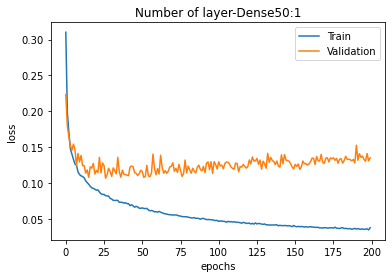

training model ...
Train set min loss: 0.028485454618930817
Val set min loss: 0.10298669338226318


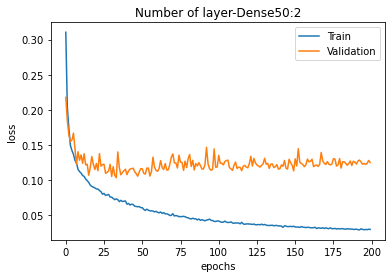

training model ...
Train set min loss: 0.027251526713371277
Val set min loss: 0.10815302282571793


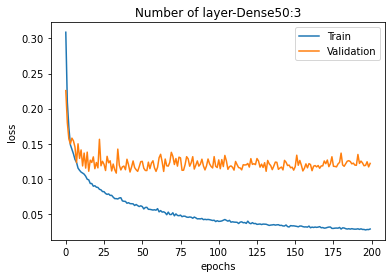

training model ...
Train set min loss: 0.025714803487062454
Val set min loss: 0.10232427716255188


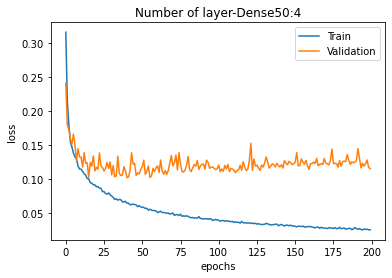

training model ...
Train set min loss: 0.026172427460551262
Val set min loss: 0.10378113389015198


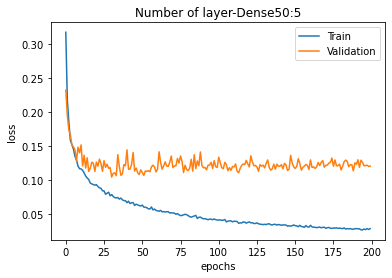

In [180]:

#hidden layer examination
Models= {}
Models['layer-Dense50']={}

for i in range(1,6):
    tf.keras.utils.set_random_seed(42)
    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='relu'))
    NN.add(Dense(100,activation='relu'))
    for j in range(i):
        NN.add(Dense(50, activation='relu'))
        
    NN.add(Dense(1,))
    NN.compile(loss ='mean_squared_error', optimizer='RMSprop',)

    Models['layer-Dense50'][i] = NN
    tf.keras.backend.clear_session()
    del NN
    
        
counter = 0
for i, model in Models['layer-Dense50'].items():
    tf.keras.utils.set_random_seed(42)
    print('training model ...')
    history = model.fit(x = x_train, y = y_train, epochs=200, verbose = 0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))
    plt.figure()
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')
    plt.title('Number of layer-Dense50:{}'.format(i))
    
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    
    

In this step we will work on activation function for our hidden layers.

training model ...
Train set min loss: 0.026742979884147644
Val set min loss: 0.10452930629253387


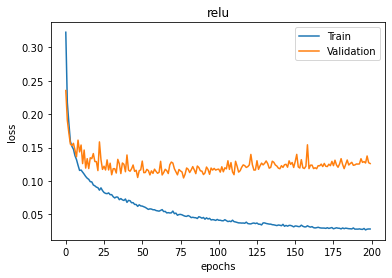

training model ...
Train set min loss: 0.09003286063671112
Val set min loss: 0.10616469383239746


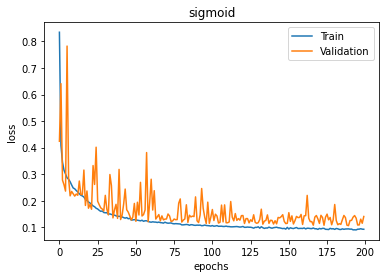

training model ...
Train set min loss: 0.022363366559147835
Val set min loss: 0.11128128319978714


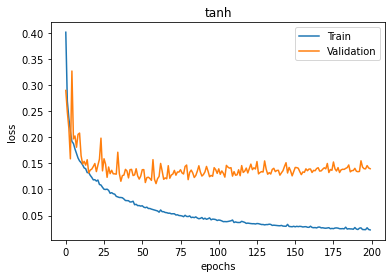

training model ...
Train set min loss: 0.026033708825707436
Val set min loss: 0.10733067989349365


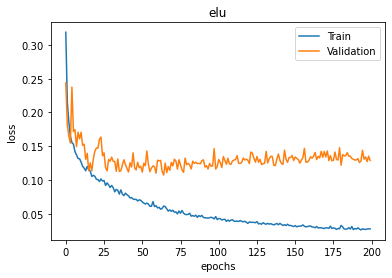

training model ...
Train set min loss: 0.02671576291322708
Val set min loss: 0.11832566559314728


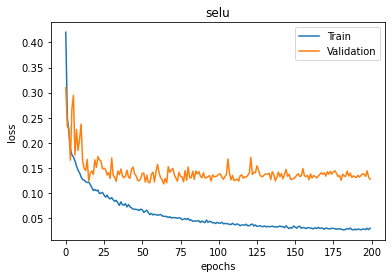

training model ...
Train set min loss: 0.9858033657073975
Val set min loss: 0.9278728365898132


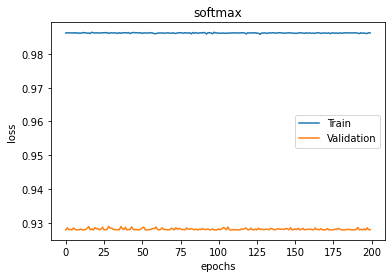

In [181]:
# activation function examination
Models['activation'] = {}

activation_func = ['relu','sigmoid','tanh','elu','selu','softmax']
for func in activation_func:
    tf.keras.utils.set_random_seed(42)
    np.random.seed(42)
    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation=func))
    NN.add(Dense(100,activation=func))
    NN.add(Dense(50, activation=func))
    for j in range(5):
        NN.add(Dense(50, activation=func))
        
    NN.add(Dense(1,))
    NN.compile(loss ='mean_squared_error', optimizer='RMSprop',)

    Models['activation'][func]=NN
    tf.keras.backend.clear_session()
    del NN
    
counter = 0
for i, model in Models['activation'].items():
    tf.keras.utils.set_random_seed(42)
    np.random.seed(42)
    print('training model ...')
    
    history = model.fit(x = x_train, y = y_train, epochs=200, verbose = 0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))
    plt.figure()
    plt.title(activation_func[counter])
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    counter += 1
    

finding a good optimizer is another parameter that we will work on it.

training model ...
Train set min loss: 0.038452208042144775
Val set min loss: 0.10133180022239685


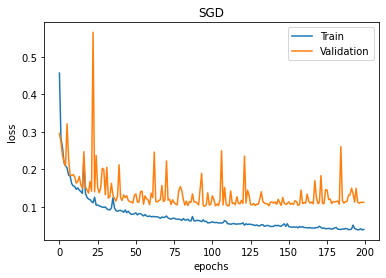

training model ...
Train set min loss: 0.026742979884147644
Val set min loss: 0.10452930629253387


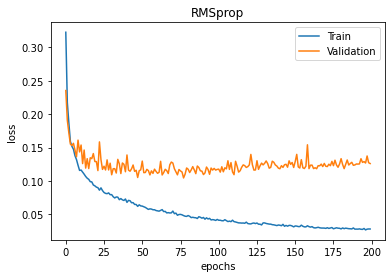

training model ...
Train set min loss: 0.020677616819739342
Val set min loss: 0.1083214282989502


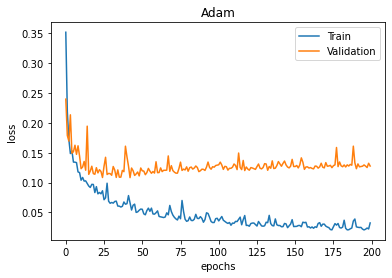

training model ...
Train set min loss: 0.3457839787006378
Val set min loss: 0.3297385573387146


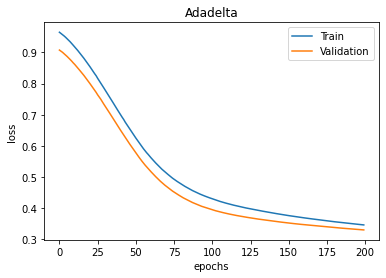

training model ...
Train set min loss: 0.14972998201847076
Val set min loss: 0.18102127313613892


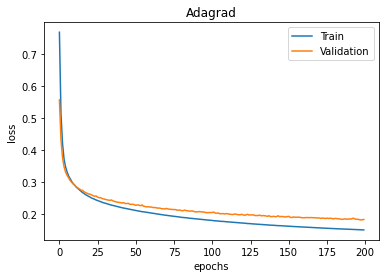

training model ...
Train set min loss: 0.0257827527821064
Val set min loss: 0.1278667151927948


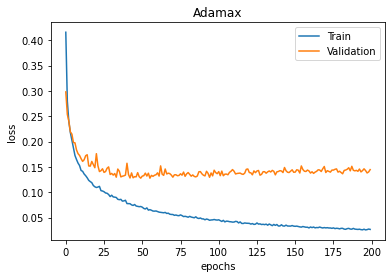

training model ...
Train set min loss: 0.02170102298259735
Val set min loss: 0.10556536167860031


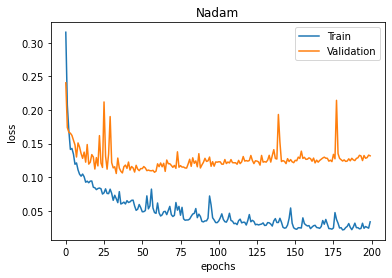

training model ...
Train set min loss: 0.9859521389007568
Val set min loss: 0.9280283451080322


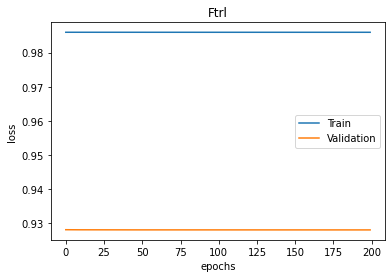

In [182]:
# optimizer examination
Models['optimizer']={}

optimizers = ['SGD','RMSprop','Adam','Adadelta','Adagrad','Adamax','Nadam','Ftrl']
for opt in optimizers:
    tf.keras.utils.set_random_seed(42)
    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='relu'))
    NN.add(Dense(100,activation='relu'))
    NN.add(Dense(50, activation='relu'))
    for j in range(5):
        NN.add(Dense(50, activation='relu'))
        
    NN.add(Dense(1,))
    NN.compile(loss ='mean_squared_error', optimizer=opt,)

    Models['optimizer'][opt]=NN
    tf.keras.backend.clear_session()
    del NN
    
counter = 0
for i, model in Models['optimizer'].items():
    tf.keras.utils.set_random_seed(42)
    print('training model ...')
    
    history = model.fit(x = x_train, y = y_train, epochs=200, verbose = 0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))
    plt.figure()
    plt.title(optimizers[counter])
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    counter += 1

learning rate would be our next step.

training model ...
Train set min loss: 1.0224303007125854
Val set min loss: 0.9278804063796997


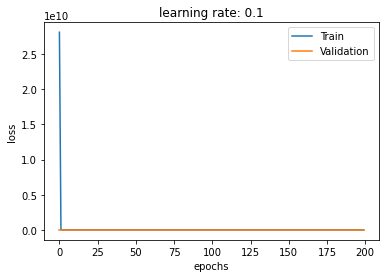

training model ...
Train set min loss: 0.9898004531860352
Val set min loss: 0.9278729557991028


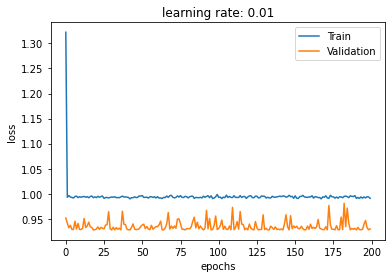

training model ...
Train set min loss: 0.0638364627957344
Val set min loss: 0.10599144548177719


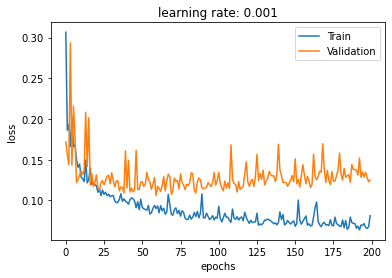

training model ...
Train set min loss: 0.025378407910466194
Val set min loss: 0.10259620100259781


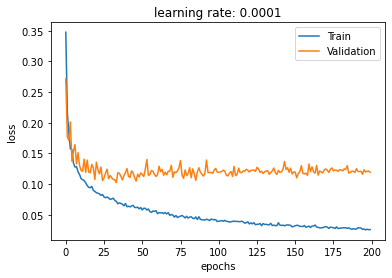

training model ...
Train set min loss: 0.04146367684006691
Val set min loss: 0.12587901949882507


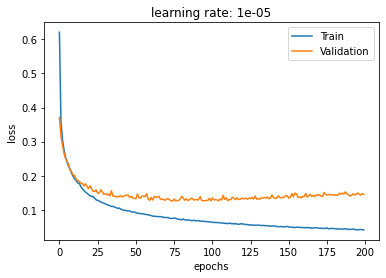

training model ...
Train set min loss: 0.14122548699378967
Val set min loss: 0.1622997522354126


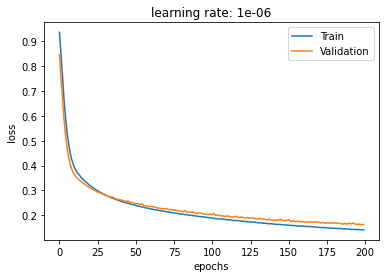

training model ...
Train set min loss: 0.32232728600502014
Val set min loss: 0.3149197995662689


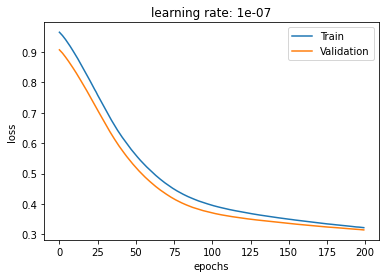

In [183]:
# learning rate examination
Models['learning_rate'] = {}

learning_rates = [0.1,0.01,0.001,0.0001,0.00001,0.000001,0.0000001]
for lr in learning_rates:
    tf.keras.utils.set_random_seed(42)
    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='relu'))
    NN.add(Dense(100,activation='relu'))
    NN.add(Dense(50, activation='relu'))
    for j in range(5):
        NN.add(Dense(50, activation='relu'))
    opt = RMSprop(learning_rate= lr, momentum=0.9)    
    NN.add(Dense(1,))
    NN.compile(loss ='mean_squared_error', optimizer=opt,)

    Models['learning_rate'][lr]=(NN)
    tf.keras.backend.clear_session()
    del NN
    
counter = 0
for i, model in Models['learning_rate'].items():
    tf.keras.utils.set_random_seed(42)
    print('training model ...')
    
    history = model.fit(x = x_train, y = y_train, epochs=200, verbose = 0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))
    plt.figure()
    plt.title('learning rate: {}'.format(learning_rates[counter]))
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    counter += 1

we will find the best loss function in this step.

training model ...
Train set min loss: 0.0638364627957344
Val set min loss: 0.10599144548177719


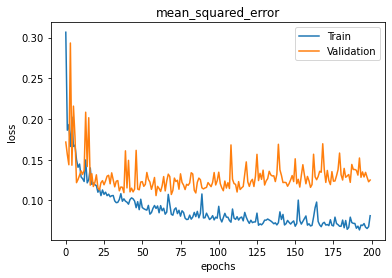

training model ...
Train set min loss: 0.1542758345603943
Val set min loss: 0.18084384500980377


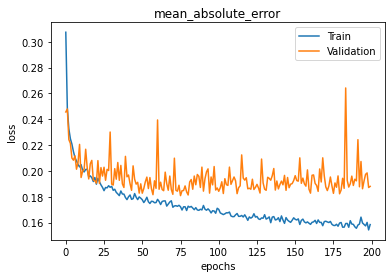

training model ...
Train set min loss: 109.64879608154297
Val set min loss: 92.49336242675781


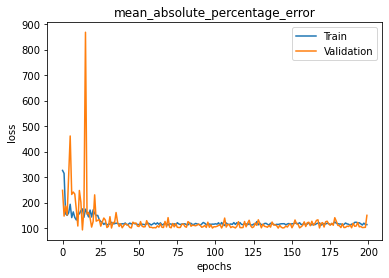

training model ...
Train set min loss: 0.00820738635957241
Val set min loss: 0.01348009705543518


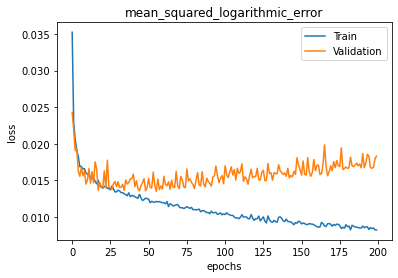

training model ...
Train set min loss: -0.4871201515197754
Val set min loss: -0.46981263160705566


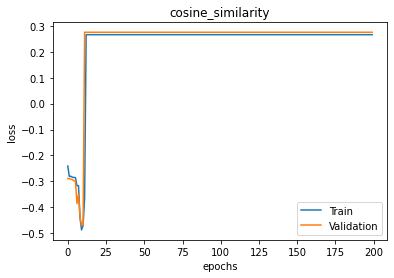

training model ...
Train set min loss: 0.027752378955483437
Val set min loss: 0.045357052236795425


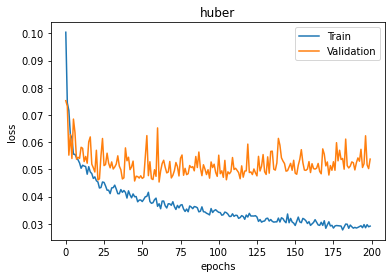

training model ...
Train set min loss: 0.026931289583444595
Val set min loss: 0.04074389860033989


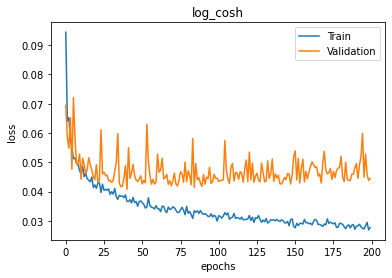

In [184]:
# loss function examination

Models['loss_function'] = {}

loss_functions = ['mean_squared_error','mean_absolute_error','mean_absolute_percentage_error',
                  'mean_squared_logarithmic_error','cosine_similarity','huber','log_cosh']

for func in loss_functions:
    tf.keras.utils.set_random_seed(42)
    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='relu'))
    NN.add(Dense(100,activation='relu'))
    NN.add(Dense(50, activation='relu'))
    for j in range(5):
        NN.add(Dense(50, activation='relu'))
    opt = RMSprop(learning_rate= 0.001, momentum=0.9)    
    NN.add(Dense(1,))
    NN.compile(loss = func, optimizer=opt,)

    Models['loss_function'][func]=NN
    tf.keras.backend.clear_session()
    del NN
    
counter = 0
for i, model in Models['loss_function'].items():
    tf.keras.utils.set_random_seed(42)
    print('training model ...')
    
    history = model.fit(x = x_train, y = y_train, epochs=200, verbose = 0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))    
    plt.figure()
    plt.title(loss_functions[counter])
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    counter += 1

The following functions can help us compare different models' performance

In [185]:
def metrics(y_predict, y_true):  #given predicted and true values, return dictionary of R2, RMSE, RMSE/mean, average abs % error
    metrics={}
    residual = y_predict - y_true
    average = np.average(y_true)
    abs_percent_error = np.absolute(np.divide(residual,y_true))*100
    metrics['R2'] = 1 - (np.sum(residual**2)/len(residual))/np.var(y_true)
    metrics['RMSE']= (np.sum(residual**2)/len(residual))**0.5
    metrics['RMSE/mean'] = metrics['RMSE'] / average
    metrics['average absolute % error'] = np.average(abs_percent_error)
    metrics['median absolute % error'] = np.median(abs_percent_error)
    return metrics

def metrics_unnorm(y_predict, y_true): #same to metrics() except un-normalizing y before calculation
    m = metrics(y_unnorm(y_predict), y_unnorm(y_true))
    return m

def compare_model(Models, x_test = None, y_test = None, data = None, style='norm'): #given nested dictionary of models in the form Models[factor][parameter], print and store metrics
    results={}
      
        
    for factor, model_para in Models.items():
        results[factor]={}
        print(str(factor)+'------------------------')
        for parameter, model in model_para.items():
            
            if data != None:
                test_set = data
                x_test = test_set[parameter][0] 
                y_test = test_set[parameter][1]
            
            if style=='norm':
                m=metrics(np.squeeze(model.predict(x_test)), y_test)
            if style=='unnorm':
                m=metrics_unnorm(np.squeeze(model.predict(x_test)), y_test)
            results[factor][parameter] = m
            R2= "{:.2f}".format(m['R2']*100)
            RMSE_div_mean = "{:.2f}".format(m['RMSE/mean']*100)
            avg_abs_percent_error = "{:.2f}".format(m['average absolute % error'])
            print('['+str(parameter)+'] R2: '+str(R2)+'%, RMSE/mean: '+str(RMSE_div_mean)+'%, avg abs % error: '+str(avg_abs_percent_error)+'%')
    return results



In [186]:
compare_results = compare_model(Models, x_test, y_test)

layer-Dense50------------------------
[1] R2: 85.45%, RMSE/mean: -2663.52%, avg abs % error: 356.42%
[2] R2: 86.56%, RMSE/mean: -2560.34%, avg abs % error: 536.89%
[3] R2: 86.85%, RMSE/mean: -2532.23%, avg abs % error: 281.95%
[4] R2: 87.55%, RMSE/mean: -2464.03%, avg abs % error: 331.99%
[5] R2: 87.06%, RMSE/mean: -2511.89%, avg abs % error: 328.88%
activation------------------------
[relu] R2: 86.41%, RMSE/mean: -2574.16%, avg abs % error: 413.36%
[sigmoid] R2: 84.85%, RMSE/mean: -2718.10%, avg abs % error: 388.96%
[tanh] R2: 84.93%, RMSE/mean: -2711.03%, avg abs % error: 419.78%
[elu] R2: 86.11%, RMSE/mean: -2602.52%, avg abs % error: 322.20%
[selu] R2: 86.24%, RMSE/mean: -2590.82%, avg abs % error: 405.24%
[softmax] R2: -0.01%, RMSE/mean: -6983.67%, avg abs % error: 108.28%
optimizer------------------------
[SGD] R2: 87.92%, RMSE/mean: -2427.65%, avg abs % error: 336.50%
[RMSprop] R2: 86.41%, RMSE/mean: -2574.16%, avg abs % error: 413.36%
[Adam] R2: 86.23%, RMSE/mean: -2591.34%, av

The above RMSE/mean and average absolute % error all look very terrible, all over 100%, because the mean of test data is nearly zero after normalization! 

Let's do an un-normalized version:


In [187]:
metrics_unnorm(np.squeeze(NN_model.predict(x_test)) , y_test)

{'R2': -0.04716331503284188,
 'RMSE': 361890.6016726629,
 'RMSE/mean': 0.6764064310568249,
 'average absolute % error': 68.11505283801348,
 'median absolute % error': 45.78652722056215}

In [188]:
compare_results = compare_model(Models, x_test, y_test, style='unnorm')

layer-Dense50------------------------
[1] R2: 85.45%, RMSE/mean: 25.21%, avg abs % error: 14.22%
[2] R2: 86.56%, RMSE/mean: 24.23%, avg abs % error: 14.59%
[3] R2: 86.85%, RMSE/mean: 23.97%, avg abs % error: 14.12%
[4] R2: 87.55%, RMSE/mean: 23.32%, avg abs % error: 13.96%
[5] R2: 87.06%, RMSE/mean: 23.78%, avg abs % error: 13.96%
activation------------------------
[relu] R2: 86.41%, RMSE/mean: 24.36%, avg abs % error: 14.03%
[sigmoid] R2: 84.85%, RMSE/mean: 25.73%, avg abs % error: 13.97%
[tanh] R2: 84.93%, RMSE/mean: 25.66%, avg abs % error: 14.49%
[elu] R2: 86.11%, RMSE/mean: 24.63%, avg abs % error: 13.47%
[selu] R2: 86.24%, RMSE/mean: 24.52%, avg abs % error: 13.85%
[softmax] R2: -0.01%, RMSE/mean: 66.10%, avg abs % error: 54.13%
optimizer------------------------
[SGD] R2: 87.92%, RMSE/mean: 22.98%, avg abs % error: 14.13%
[RMSprop] R2: 86.41%, RMSE/mean: 24.36%, avg abs % error: 14.03%
[Adam] R2: 86.23%, RMSE/mean: 24.53%, avg abs % error: 14.58%
[Adadelta] R2: 64.46%, RMSE/mean:

## Summary of preliminary model comparisons



For practical purpose, absolute percentage error would be the major concern for buyers and sellers for different price levels. Hence, we will evaluate model performance mainly based on this metrics - average absolute percentage error.




### Number of Layers

Adding more layers of Dense(50) only generates worse R2 and fluctating percentage error in different random states (sometimes better, sometimes worse). So for simplicity, we will choose to focus our work on fewer layers. The model with 1 added layer of Dense(50) is 17/100/50/1, with 3 hidden layers and 1 output layer, which would be our base model for tunning in the next stage.



### Activation Function

Exponential Linear Unit (elu) is the best performer. It is a function that tend to converge cost to zero faster and produce more accurate results. It is similar to RELU, except that it can produce negative values.


### Optimizer

Nadam performs the best but if we look the graph we can see fluctuates for validation set. So we wouldn't risk it and we chose the second option which is RMSProp and is more stable than Nadam.


### Learning Rate

Laerning rate of 0.0001 produces the best result.


### Loss Function

One intetesting result is that, measured by average absolute percentage error, the loss function of mean_absolute_percentage_error perfoms not satisfactory! One major reason is standard normalization would make measure based on percentage of predicted values very unstable, as the mean of predicted value is zero, the measure could approach infinity. The squaring of error may become smaller for error values below 1, so mean_squared_error may not be good choice. 

Let's choose the best performer from above results - the mean_absolute_error.


## Further tuning with regularization

From above, we will focus on neural network with structure 17/17/100/50/1, elu as activation function, RMSProp as optimizer, learning rate at 0.0001, loss function "mean_absolute_error".

Note that previously we have not yet tuned with regularization, such as dropout, L2 regularization. One useful technique is to compare testing accuracy with training accuracy to detect under-fitting or over-fitting. 

In [190]:
#Base Structure v2

NN_model2 = Sequential()
NN_model2.add(Dense(17,input_dim = x_train.shape[1], activation='elu'))
NN_model2.add(Dense(100,activation='elu'))
NN_model2.add(Dense(50, activation='elu'))
NN_model2.add(Dense(1,))

opt = RMSprop(learning_rate = 0.0001)  
# Compile the network :
NN_model2.compile(loss ='mean_absolute_error', optimizer=opt,)
NN_model2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 17)                340       
                                                                 
 dense_1 (Dense)             (None, 100)               1800      
                                                                 
 dense_2 (Dense)             (None, 50)                5050      
                                                                 
 dense_3 (Dense)             (None, 1)                 51        
                                                                 
Total params: 7,241
Trainable params: 7,241
Non-trainable params: 0
_________________________________________________________________


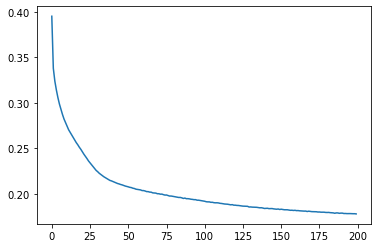

In [191]:
tf.keras.utils.set_random_seed(42)
history = NN_model2.fit(x = x_train, y = y_train, epochs=200, verbose = 0)

plt.plot(history.history['loss'])

In [192]:
metrics_unnorm(np.squeeze(NN_model2.predict(x_train)) , y_train)

{'R2': 0.9027601471671705,
 'RMSE': 113677.86798633654,
 'RMSE/mean': 0.2106930573036948,
 'average absolute % error': 12.195159242240711,
 'median absolute % error': 8.446120661810728}

In [193]:
metrics_unnorm(np.squeeze(NN_model2.predict(x_test)) , y_test)

{'R2': 0.8773414256060752,
 'RMSE': 123856.57072612474,
 'RMSE/mean': 0.23149918948039863,
 'average absolute % error': 12.954825821512845,
 'median absolute % error': 9.291035156249999}

In [194]:
Models2 = {}

Models2['L2'] = {}

for r in [0,0.0001,0.001,0.01,0.1,1]:
    tf.keras.utils.set_random_seed(42)

    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='elu'))
    NN.add(Dense(100,activation='elu'))
    NN.add(Dense(50, activation='elu'))
    NN.add(Dense(1,))
    regularizers.l2(l2=r)
    opt = RMSprop(learning_rate = 0.0001)  
    # Compile the network :
    NN.compile(loss ='mean_absolute_error', optimizer=opt,)
    NN.fit(x = x_train, y = y_train, epochs=200, verbose=0)
    Models2['L2'][r] = NN
    
    tf.keras.backend.clear_session()
    del NN



In [195]:
compare_results = compare_model(Models2, x_test, y_test, style='unnorm')

L2------------------------
[0] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.0001] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.001] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.01] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.1] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[1] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%


As we can see the error didn't changed for differnet L2 values, So we may ignore it for our final model.

In [203]:
Models2['Dropout']={}
for drop in [0, 0.05, 0.1, 0.2, 0.4, 0.8]:
    tf.keras.utils.set_random_seed(42)

    NN = Sequential()
    NN.add(Dense(17,input_dim = x_train.shape[1], activation='elu'))
    NN.add(Dropout(drop))
    NN.add(Dense(100,activation='elu'))
    NN.add(Dropout(drop))
    NN.add(Dense(50, activation='elu'))
    NN.add(Dropout(drop))
    NN.add(Dense(1,))
    regularizers.l2(l2=0.0001)
    opt = RMSprop(learning_rate = 0.0001)  
    # Compile the network :
    NN.compile(loss ='mean_absolute_error', optimizer=opt,)
    NN.fit(x = x_train, y = y_train, epochs=200, verbose = 0 )
    Models2['Dropout'][drop] = NN
    
    tf.keras.backend.clear_session()
    del NN

In [204]:
compare_results = compare_model(Models2, x_test, y_test, style='unnorm')

L2------------------------
[0] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.0001] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.001] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.01] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.1] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[1] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
Dropout------------------------
[0] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[0.05] R2: 84.93%, RMSE/mean: 25.66%, avg abs % error: 13.55%
[0.1] R2: 83.53%, RMSE/mean: 26.83%, avg abs % error: 14.00%
[0.2] R2: 81.53%, RMSE/mean: 28.41%, avg abs % error: 14.73%
[0.4] R2: 76.59%, RMSE/mean: 31.98%, avg abs % error: 16.22%
[0.8] R2: 57.02%, RMSE/mean: 43.33%, avg abs % error: 21.98%


From above result, dropout doesn't improve the performance and hence we will not use dropout.

The next thing that we would try is using one-hot encoding for some columns that somehow can be interpreted as categorical, such as zipcode, view (with 5 possible values), condition (with 5 possible values) and grade (with 13 possible values). We would build dummy column for each of them to see how it can affect the accuracy of the model. There are 8 variations to make one-hot encoding for them or not. An iteration over all of them and comparing the results on train and validation dataset would give us the idea to keep which columns and remove others:

In [205]:
pd.get_dummies(kc_data, columns=['zipcode'])

,Unnamed: 0,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,zipcode_98146,zipcode_98148,zipcode_98155,zipcode_98166,zipcode_98168,zipcode_98177,zipcode_98178,zipcode_98188,zipcode_98198,zipcode_98199
0,0,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,0,0,0,0,0,0,1,0,0,0
1,1,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,299,180000.0,2,1.00,770,10000,1.0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21607,21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,0,0,0,0,0,0,0,0,0,0
21608,21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,1,0,0,0,0,0,0,0,0,0
21609,21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,0,0,0,0,0,0,0,0,0,0
21610,21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [206]:
pd.get_dummies(kc_data, columns=['view'])

,Unnamed: 0,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,...,zipcode,lat,long,sqft_living15,sqft_lot15,view_0,view_1,view_2,view_3,view_4
0,0,164,221900.0,3,1.00,1180,5650,1.0,0,3,...,98178,47.5112,-122.257,1340,5650,1,0,0,0,0
1,1,221,538000.0,3,2.25,2570,7242,2.0,0,3,...,98125,47.7210,-122.319,1690,7639,1,0,0,0,0
2,2,299,180000.0,2,1.00,770,10000,1.0,0,3,...,98028,47.7379,-122.233,2720,8062,1,0,0,0,0
3,3,221,604000.0,4,3.00,1960,5000,1.0,0,5,...,98136,47.5208,-122.393,1360,5000,1,0,0,0,0
4,4,292,510000.0,3,2.00,1680,8080,1.0,0,3,...,98074,47.6168,-122.045,1800,7503,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21607,21608,19,360000.0,3,2.50,1530,1131,3.0,0,3,...,98103,47.6993,-122.346,1530,1509,1,0,0,0,0
21608,21609,297,400000.0,4,2.50,2310,5813,2.0,0,3,...,98146,47.5107,-122.362,1830,7200,1,0,0,0,0
21609,21610,52,402101.0,2,0.75,1020,1350,2.0,0,3,...,98144,47.5944,-122.299,1020,2007,1,0,0,0,0
21610,21611,259,400000.0,3,2.50,1600,2388,2.0,0,3,...,98027,47.5345,-122.069,1410,1287,1,0,0,0,0


In [207]:
pd.get_dummies(kc_data, columns=['condition'])

,Unnamed: 0,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,zipcode,lat,long,sqft_living15,sqft_lot15,condition_1,condition_2,condition_3,condition_4,condition_5
0,0,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,98178,47.5112,-122.257,1340,5650,0,0,1,0,0
1,1,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,98125,47.7210,-122.319,1690,7639,0,0,1,0,0
2,2,299,180000.0,2,1.00,770,10000,1.0,0,0,...,98028,47.7379,-122.233,2720,8062,0,0,1,0,0
3,3,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,98136,47.5208,-122.393,1360,5000,0,0,0,0,1
4,4,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,98074,47.6168,-122.045,1800,7503,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21607,21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,98103,47.6993,-122.346,1530,1509,0,0,1,0,0
21608,21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,98146,47.5107,-122.362,1830,7200,0,0,1,0,0
21609,21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,98144,47.5944,-122.299,1020,2007,0,0,1,0,0
21610,21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,98027,47.5345,-122.069,1410,1287,0,0,1,0,0


In [208]:
pd.get_dummies(kc_data, columns=['grade'])

,Unnamed: 0,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade_4,grade_5,grade_6,grade_7,grade_8,grade_9,grade_10,grade_11,grade_12,grade_13
0,0,164,221900.0,3,1.00,1180,5650,1.0,0,0,...,0,0,0,1,0,0,0,0,0,0
1,1,221,538000.0,3,2.25,2570,7242,2.0,0,0,...,0,0,0,1,0,0,0,0,0,0
2,2,299,180000.0,2,1.00,770,10000,1.0,0,0,...,0,0,1,0,0,0,0,0,0,0
3,3,221,604000.0,4,3.00,1960,5000,1.0,0,0,...,0,0,0,1,0,0,0,0,0,0
4,4,292,510000.0,3,2.00,1680,8080,1.0,0,0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21607,21608,19,360000.0,3,2.50,1530,1131,3.0,0,0,...,0,0,0,0,1,0,0,0,0,0
21608,21609,297,400000.0,4,2.50,2310,5813,2.0,0,0,...,0,0,0,0,1,0,0,0,0,0
21609,21610,52,402101.0,2,0.75,1020,1350,2.0,0,0,...,0,0,0,1,0,0,0,0,0,0
21610,21611,259,400000.0,3,2.50,1600,2388,2.0,0,0,...,0,0,0,0,1,0,0,0,0,0


Creating different variation of one-hot encoding for our dataset

In [209]:
from itertools import chain, combinations

def powerset(iterable):
    s = list(iterable)
    return list(chain.from_iterable(combinations(s, r) for r in range(len(s)+1)))

get_dummy = ['zipcode','view','condition','grade']

# all possible variation of making a dummy column for each one
variations = powerset(get_dummy)
variations

[(),
 ('zipcode',),
 ('view',),
 ('condition',),
 ('grade',),
 ('zipcode', 'view'),
 ('zipcode', 'condition'),
 ('zipcode', 'grade'),
 ('view', 'condition'),
 ('view', 'grade'),
 ('condition', 'grade'),
 ('zipcode', 'view', 'condition'),
 ('zipcode', 'view', 'grade'),
 ('zipcode', 'condition', 'grade'),
 ('view', 'condition', 'grade'),
 ('zipcode', 'view', 'condition', 'grade')]

Creating model for every variation

Train set min loss: 0.17786544561386108
Val set min loss: 0.18904225528240204


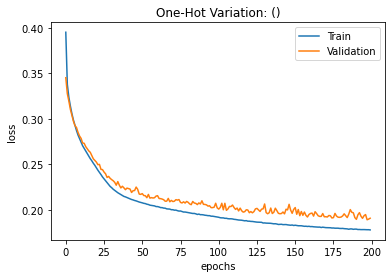

Train set min loss: 0.1677693873643875
Val set min loss: 0.1832973062992096


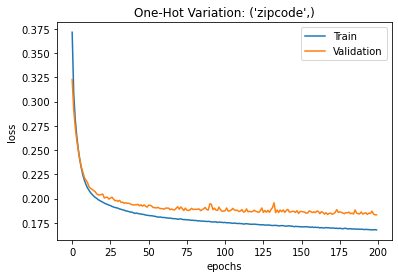

Train set min loss: 0.17592820525169373
Val set min loss: 0.18845251202583313


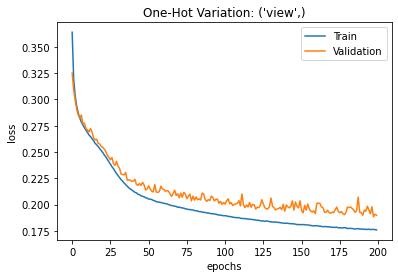

Train set min loss: 0.1763676553964615
Val set min loss: 0.18834549188613892


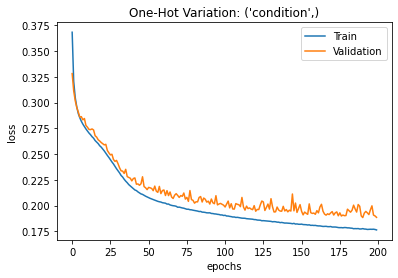

Train set min loss: 0.17602555453777313
Val set min loss: 0.19189460575580597


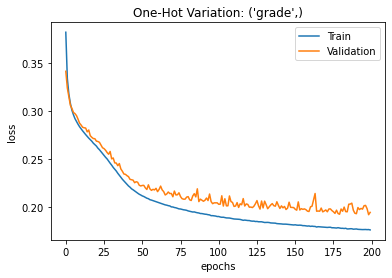

Train set min loss: 0.16665609180927277
Val set min loss: 0.1832370162010193


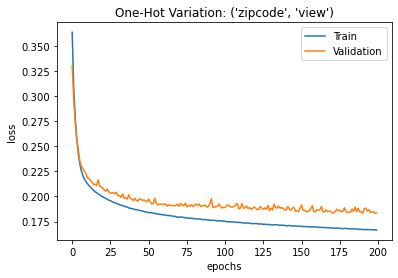

Train set min loss: 0.16586212813854218
Val set min loss: 0.182888925075531


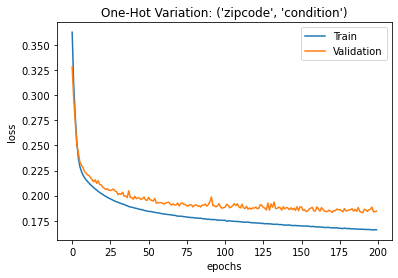

Train set min loss: 0.1658991426229477
Val set min loss: 0.18287721276283264


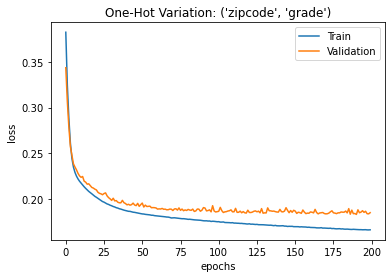

Train set min loss: 0.17544959485530853
Val set min loss: 0.18827323615550995


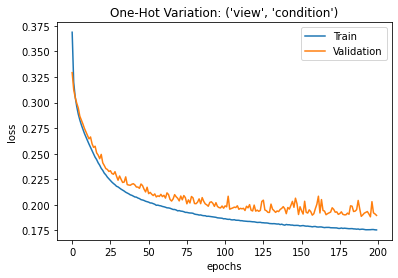

Train set min loss: 0.17561811208724976
Val set min loss: 0.19277729094028473


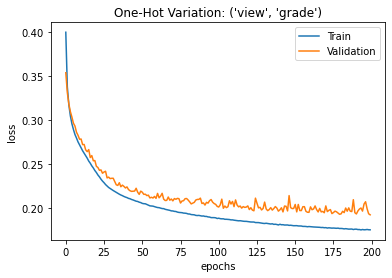

Train set min loss: 0.1759261190891266
Val set min loss: 0.19355075061321259


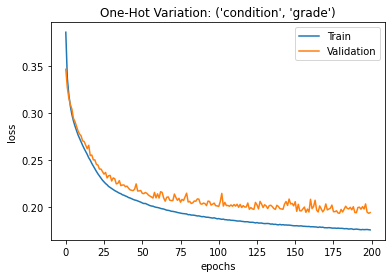

Train set min loss: 0.16560614109039307
Val set min loss: 0.18247395753860474


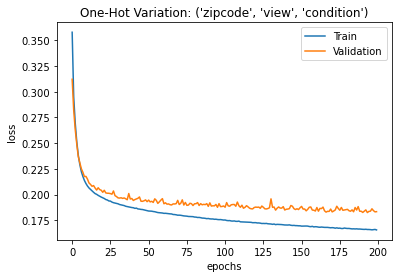

Train set min loss: 0.16543461382389069
Val set min loss: 0.18392792344093323


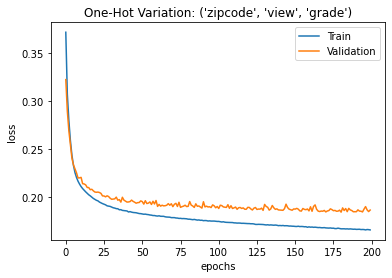

Train set min loss: 0.16695228219032288
Val set min loss: 0.18463124334812164


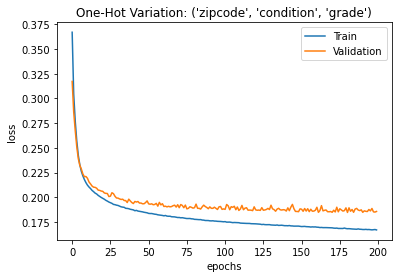

Train set min loss: 0.1753445565700531
Val set min loss: 0.1908539980649948


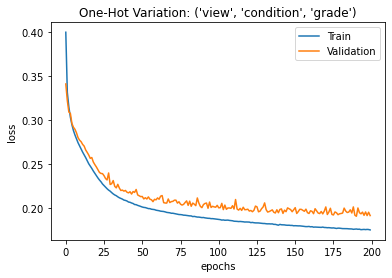

Train set min loss: 0.16729974746704102
Val set min loss: 0.18336337804794312


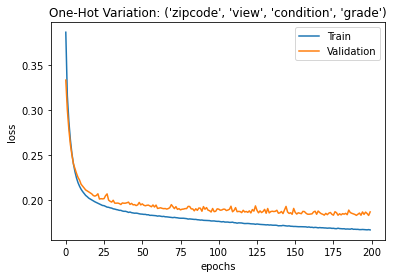

In [212]:
Models3 = {}
Models3['one-hot'] = {}
data = {}
for variant in variations:
    tf.keras.utils.set_random_seed(42)
    new_kc = kc_data.copy()

    for column in new_kc.columns:
        
        if column not in variant:

            new_kc[column] = (new_kc[column] - new_kc[column].mean()) /new_kc[column].std()
        else:
            pass

    for column in variant:
        new_kc = pd.get_dummies(new_kc, columns=[column])
        
    new_kc_data_norm = new_kc.copy()

        
    new_target = new_kc_data_norm['price']
    new_data = new_kc_data_norm.drop(['price'], axis = 1)
    x_train, x_final_test, y_train, y_final_test = train_test_split(new_data, new_target, test_size = 0.2,  random_state=42)
    x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size = 0.25,  random_state=42)
    NN_model2 = Sequential()
    NN_model2.add(Dense(17,input_dim = x_train.shape[1], activation='elu'))
    NN_model2.add(Dense(100,activation='elu'))
    NN_model2.add(Dense(50, activation='elu'))
    NN_model2.add(Dense(1,))
    opt = RMSprop(learning_rate = 0.0001)
    NN_model2.compile(loss ='mean_absolute_error', optimizer=opt,)
    history = NN_model2.fit(x = x_train, y = y_train, epochs=200, verbose=0, validation_data=(x_test, y_test))
    print('Train set min loss: {}'.format(min(history.history['loss'])))
    print('Val set min loss: {}'.format(min(history.history['val_loss'])))
    plt.figure()
    plt.plot(history.history['loss'], label = 'Train')
    plt.plot(history.history['val_loss'], label = 'Validation')    
    plt.title('One-Hot Variation: {}'.format(variant))
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.legend()
    plt.show()
    Models3['one-hot'][variant] = NN_model2
    data[variant] = [x_test,y_test, x_train, y_train,]
    tf.keras.backend.clear_session()
    del NN_model2   


In [213]:
compare_results = compare_model(Models3, data =data, style='unnorm')

one-hot------------------------
[()] R2: 87.73%, RMSE/mean: 23.15%, avg abs % error: 12.95%
[('zipcode',)] R2: 88.90%, RMSE/mean: 22.03%, avg abs % error: 12.75%
[('view',)] R2: 87.39%, RMSE/mean: 23.47%, avg abs % error: 12.91%
[('condition',)] R2: 87.86%, RMSE/mean: 23.03%, avg abs % error: 12.93%
[('grade',)] R2: 87.03%, RMSE/mean: 23.80%, avg abs % error: 13.42%
[('zipcode', 'view')] R2: 88.66%, RMSE/mean: 22.26%, avg abs % error: 12.63%
[('zipcode', 'condition')] R2: 88.61%, RMSE/mean: 22.31%, avg abs % error: 12.63%
[('zipcode', 'grade')] R2: 88.71%, RMSE/mean: 22.21%, avg abs % error: 12.70%
[('view', 'condition')] R2: 87.64%, RMSE/mean: 23.24%, avg abs % error: 12.77%
[('view', 'grade')] R2: 86.70%, RMSE/mean: 24.11%, avg abs % error: 13.01%
[('condition', 'grade')] R2: 86.43%, RMSE/mean: 24.35%, avg abs % error: 13.03%
[('zipcode', 'view', 'condition')] R2: 88.84%, RMSE/mean: 22.08%, avg abs % error: 12.60%
[('zipcode', 'view', 'grade')] R2: 88.60%, RMSE/mean: 22.32%, avg abs 

So we can see making zipcode, view and condition is more beneficial for our model.

# Project Conclusion

In this final step we can compare our models' performance on test dataset which is splitted with the name of final_test. We should also one-hot view, condition and zipcode before using ANN. 

The comparison would be based on R2, average and median % error.

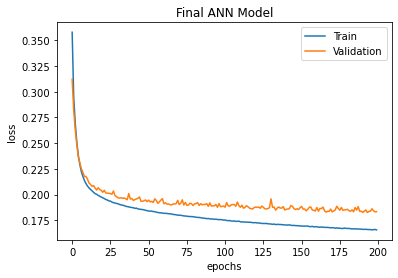

In [215]:
tf.keras.utils.set_random_seed(42)
new_kc = kc_data.copy()

for column in new_kc.columns:

    if column not in  ['zipcode','view','condition']:

        new_kc[column] = (new_kc[column] - new_kc[column].mean()) /new_kc[column].std()
    else:
        pass

for column in  ['zipcode','view','condition']:
    new_kc = pd.get_dummies(new_kc, columns=[column])
        
new_kc_data_norm = new_kc.copy()
    
new_target = new_kc_data_norm['price']
new_data = new_kc_data_norm.drop(['price'], axis = 1)

x_train, x_final_test, y_train, y_final_test = train_test_split(new_data, new_target, test_size = 0.2, random_state=42)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size = 0.25,  random_state=42)

NN_model_final = Sequential()
NN_model_final.add(Dense(17,input_dim = x_train.shape[1], activation='elu'))
NN_model_final.add(Dense(100,activation='elu'))
NN_model_final.add(Dense(50, activation='elu'))
NN_model_final.add(Dense(1,))
opt = RMSprop(learning_rate = 0.0001)
NN_model_final.compile(loss ='mean_absolute_error', optimizer=opt,)
history = NN_model_final.fit(x = x_train, y = y_train, epochs=200, verbose=0, validation_data=(x_test, y_test))
plt.figure()
plt.plot(history.history['loss'], label = 'Train')
plt.plot(history.history['val_loss'], label = 'Validation')
plt.title('Final ANN Model')
plt.xlabel("epochs")
plt.ylabel("loss")
plt.legend()
plt.show()


In [219]:
metrics_unnorm(np.squeeze(NN_model_final.predict(x_train)) , y_train)

{'R2': 0.9128698858456041,
 'RMSE': 107606.35359816722,
 'RMSE/mean': 0.19943997918420964,
 'average absolute % error': 11.514546116587766,
 'median absolute % error': 7.988634885204082}

In [220]:
y_predicted = NN_model_final.predict(x_final_test)
y_predicted = y_predicted.squeeze()

In [221]:
metrics_unnorm(y_predicted, y_final_test)

{'R2': 0.8933410057690707,
 'RMSE': 126523.13874818102,
 'RMSE/mean': 0.23140096995876225,
 'average absolute % error': 12.603717661942268,
 'median absolute % error': 9.0149375}

In [132]:
new_kc = kc_data.copy()

new_target = new_kc['price']
new_data = new_kc.drop(['price'], axis = 1)

x_train, x_final_test, y_train, y_final_test = train_test_split(new_data, new_target, test_size = 0.2, random_state=42)
x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size = 0.25,  random_state=42)



metrics(neigh.predict(X_norm(x_final_test)[optimal_feature]),y_final_test)

{'R2': 0.8597398402694534,
 'RMSE': 145090.30035902376,
 'RMSE/mean': 0.26535886294686895,
 'average absolute % error': 14.401979303733773,
 'median absolute % error': 9.93469721658272}

As we can see ANN performed better for our project in comparison with KNN in all metrics. So we can say the ANN model is more robust for the dataset that we are 